In [ ]:
!nvidia-smi

Mon Feb 26 02:47:26 2024       
+---------------------------------------------------------------------------------------+
| NVIDIA-SMI 535.104.05             Driver Version: 535.104.05   CUDA Version: 12.2     |
|-----------------------------------------+----------------------+----------------------+
| GPU  Name                 Persistence-M | Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp   Perf          Pwr:Usage/Cap |         Memory-Usage | GPU-Util  Compute M. |
|                                         |                      |               MIG M. |
|=========================================+======================+======================|
|   0  Tesla V100-SXM2-16GB           Off | 00000000:00:04.0 Off |                    0 |
| N/A   31C    P0              24W / 300W |      0MiB / 16384MiB |      0%      Default |
|                                         |                      |                  N/A |
+-----------------------------------------+----------------------+--

In [ ]:
import os
HOME = os.getcwd()
print(HOME)

/content


In [ ]:
!pip install ultralytics

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 716.0/716.0 kB 11.2 MB/s eta 0:00:00


In [ ]:
import ultralytics

import glob
from IPython.display import Image, display

ultralytics.checks()

Ultralytics YOLOv8.1.18 🚀 Python-3.10.12 torch-2.1.0+cu121 CUDA:0 (Tesla V100-SXM2-16GB, 16151MiB)
Setup complete ✅ (8 CPUs, 51.0 GB RAM, 26.3/201.2 GB disk)


In [ ]:
from google.colab import drive
drive.mount('/content/drive')


Mounted at /content/drive


In [ ]:
from ultralytics import YOLO

In [ ]:
!ls  '/content/drive/MyDrive/Data298AandB/Grounding_DINO/YOLO_Classification'

data  tesnsorboard.ipynb  yolov8m.ipynb  yolov8n.ipynb	yolov8s.ipynb


In [ ]:
import shutil
#shutil.rmtree('/content/drive/MyDrive/Data298AandB/Grounding_DINO/YOLO_Classification/data/runs', ignore_errors=True)

In [ ]:
!ls  '/content/drive/MyDrive/Data298AandB/Grounding_DINO/YOLO_Classification/data'

data.yaml  runs  test  train  val  yolov8n-cls.pt  yolov8n.pt


In [ ]:
#Already unzipped
#!unzip -u '/content/gdrive/MyDrive/Data298AandB/data/train_val_test.zip' -d '/content/gdrive/MyDrive/Data298AandB/data'

In [ ]:
DATA_DIR= '/content/drive/MyDrive/Data298AandB/Grounding_DINO/YOLO_Classification/data'
DATA_DIR

'/content/drive/MyDrive/Data298AandB/Grounding_DINO/YOLO_Classification/data'

In [ ]:
!ls '/content/drive/MyDrive/Data298AandB/Grounding_DINO/YOLO_Classification/data'



data.yaml  runs  test  train  val  yolov8n-cls.pt  yolov8n.pt


In [ ]:
DATA_DIR

'/content/drive/MyDrive/Data298AandB/Grounding_DINO/YOLO_Classification/data'

In [ ]:
os.getcwd()

'/content'

In [ ]:
os.chdir('/content/drive/MyDrive/Data298AandB/Grounding_DINO/YOLO_Classification/data')
os.getcwd()

'/content/drive/MyDrive/Data298AandB/Grounding_DINO/YOLO_Classification/data'

In [ ]:
!pip install tensorboard

In [ ]:
%load_ext tensorboard

In [ ]:
%tensorboard --logdir /content/drive/MyDrive/Data298AandB/Grounding_DINO/YOLO_Classification/data/runs/classify/train2

Reusing TensorBoard on port 6006 (pid 3214), started 7:52:53 ago. (Use '!kill 3214' to kill it.)

<IPython.core.display.Javascript object>

In [ ]:
#!yolo task=classify mode=train model=yolov8m-cls.pt data='{DATA_DIR}' epochs=10 imgsz=416
!yolo task=classify mode=train data='{DATA_DIR}' model=yolov8s-cls.pt epochs=100 imgsz=640

100% 12.2M/12.2M [00:00<00:00, 183MB/s]
Ultralytics YOLOv8.1.18 🚀 Python-3.10.12 torch-2.1.0+cu121 CUDA:0 (Tesla V100-SXM2-16GB, 16151MiB)
engine/trainer: task=classify, mode=train, model=yolov8s-cls.pt, data=/content/drive/MyDrive/Data298AandB/Grounding_DINO/YOLO_Classification/data, epochs=100, time=None, patience=100, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=train2, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False,

In [ ]:
{DATA_DIR}

{'/content/drive/MyDrive/Data298AandB/Grounding_DINO/YOLO_Classification/data'}

In [ ]:
!ls  '{DATA_DIR}/runs/classify/train2'

args.yaml					    train_batch155250.jpg  val_batch1_labels.jpg
confusion_matrix_normalized.png			    train_batch155251.jpg  val_batch1_pred.jpg
confusion_matrix.png				    train_batch155252.jpg  val_batch2_labels.jpg
events.out.tfevents.1708916058.912c19841504.3722.0  train_batch1.jpg	   val_batch2_pred.jpg
results.csv					    train_batch2.jpg	   weights
results.png					    val_batch0_labels.jpg
train_batch0.jpg				    val_batch0_pred.jpg


In [ ]:
!ls  '{DATA_DIR}/runs/classify/train2/weights'

best.pt  last.pt


In [ ]:
{DATA_DIR}

{'/content/drive/MyDrive/Data298AandB/Grounding_DINO/YOLO_Classification/data'}

In [ ]:
!yolo task=classify mode=val data='{DATA_DIR}' model={DATA_DIR}/runs/classify/train2/weights/last.pt

Ultralytics YOLOv8.1.18 🚀 Python-3.10.12 torch-2.1.0+cu121 CUDA:0 (Tesla V100-SXM2-16GB, 16151MiB)
YOLOv8s-cls summary (fused): 73 layers, 5089291 parameters, 0 gradients, 12.5 GFLOPs
train: /content/drive/MyDrive/Data298AandB/Grounding_DINO/YOLO_Classification/data/train... found 27590 images in 11 classes ✅ 
val: /content/drive/MyDrive/Data298AandB/Grounding_DINO/YOLO_Classification/data/val... found 2006 images in 11 classes ✅ 
test: /content/drive/MyDrive/Data298AandB/Grounding_DINO/YOLO_Classification/data/test... found 2001 images in 11 classes ✅ 
val: Scanning /content/drive/MyDrive/Data298AandB/Grounding_DINO/YOLO_Classification/data/val... 2006 images, 0 corrupt: 100% 2006/2006 [00:00<?, ?it/s]
               classes   top1_acc   top5_acc: 100% 126/126 [00:14<00:00,  8.99it/s]
                   all       0.94      0.996
Speed: 0.7ms preprocess, 1.7ms inference, 0.0ms loss, 0.0ms postprocess per image
Results saved to runs/classify/val3
💡 Learn more at https://docs.ultralytics

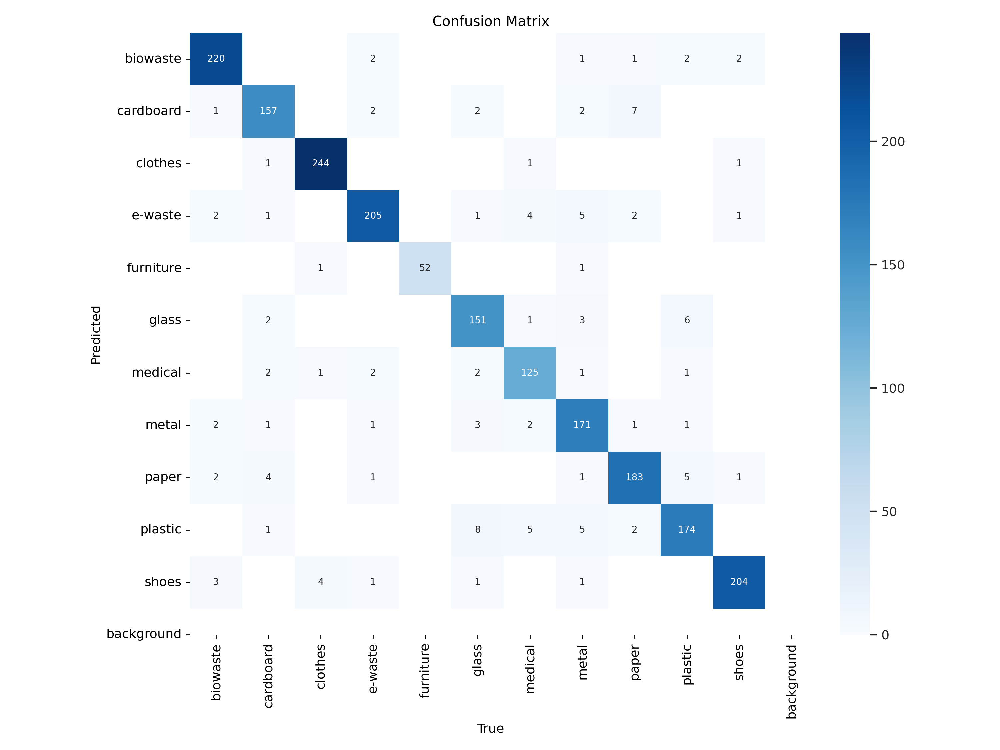

In [ ]:
Image(filename=f'{DATA_DIR}/runs/classify/val3/confusion_matrix.png')

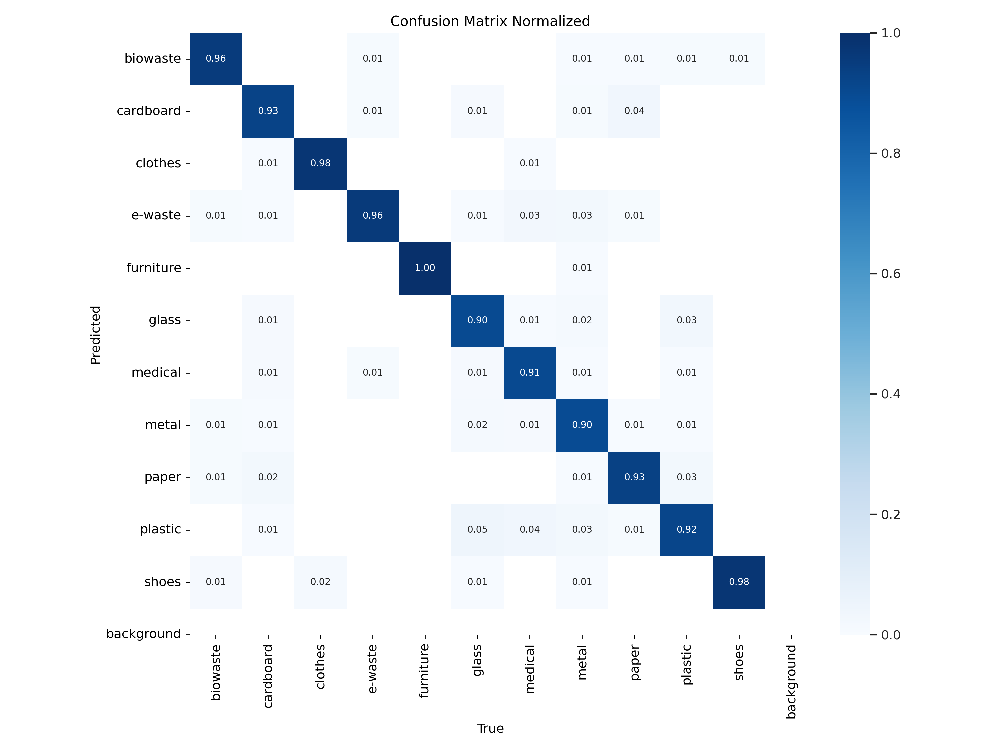

In [ ]:
Image(filename=f'{DATA_DIR}/runs/classify/val3/confusion_matrix_normalized.png')

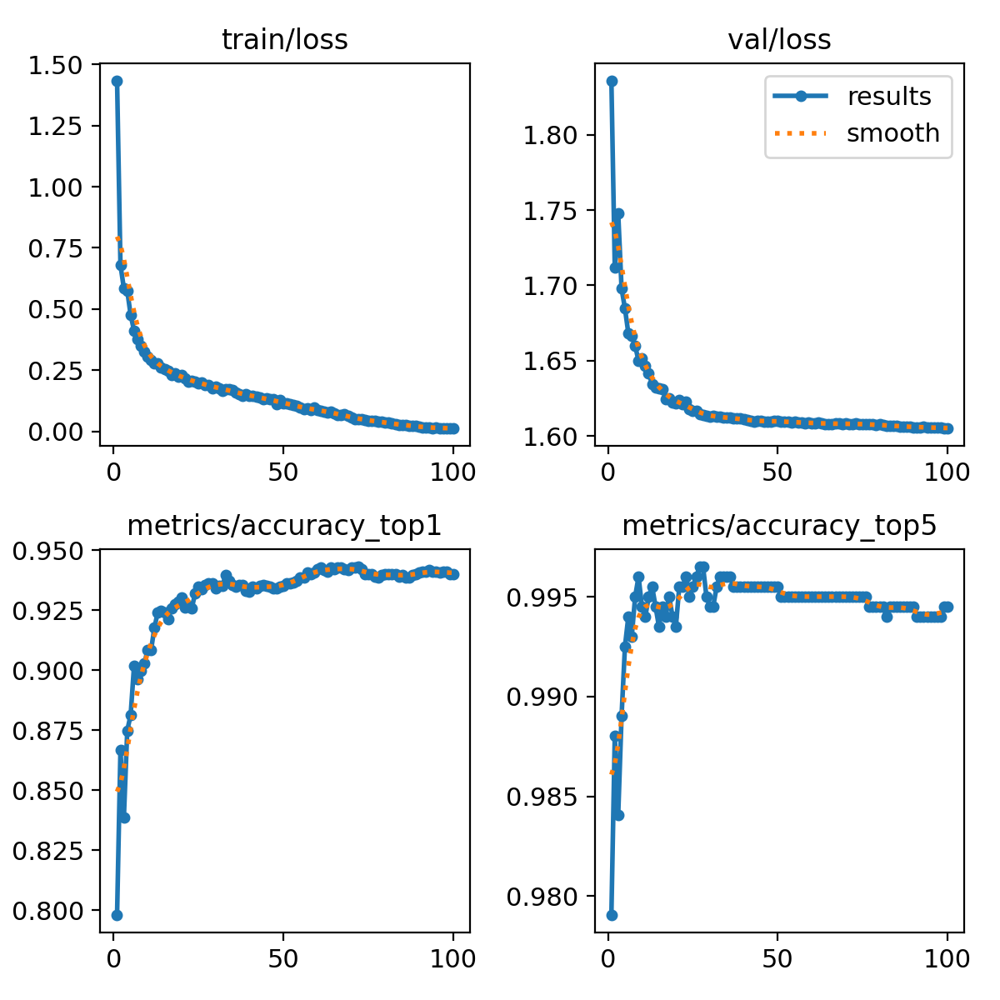

In [ ]:
Image(filename=f'{DATA_DIR}/runs/classify/train2/results.png')

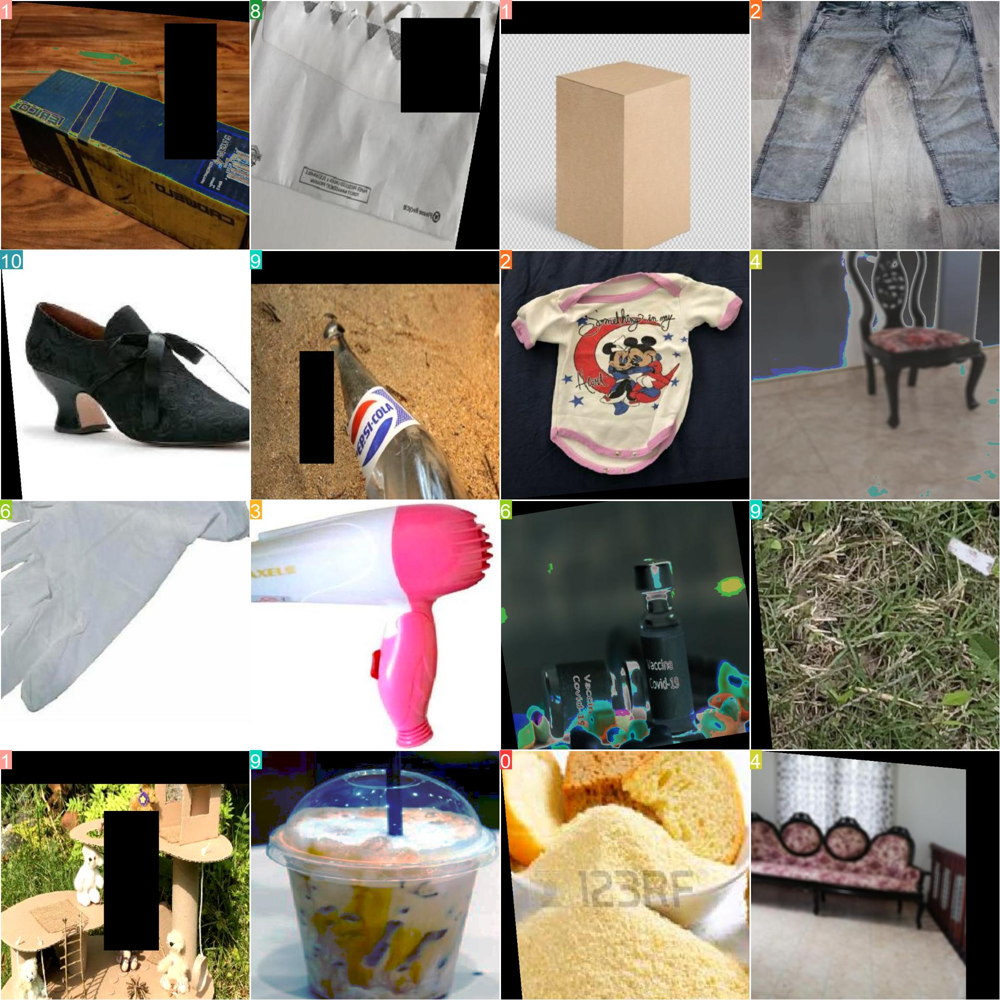

In [ ]:
Image(filename=f'{DATA_DIR}/runs/classify/train2/train_batch0.jpg')

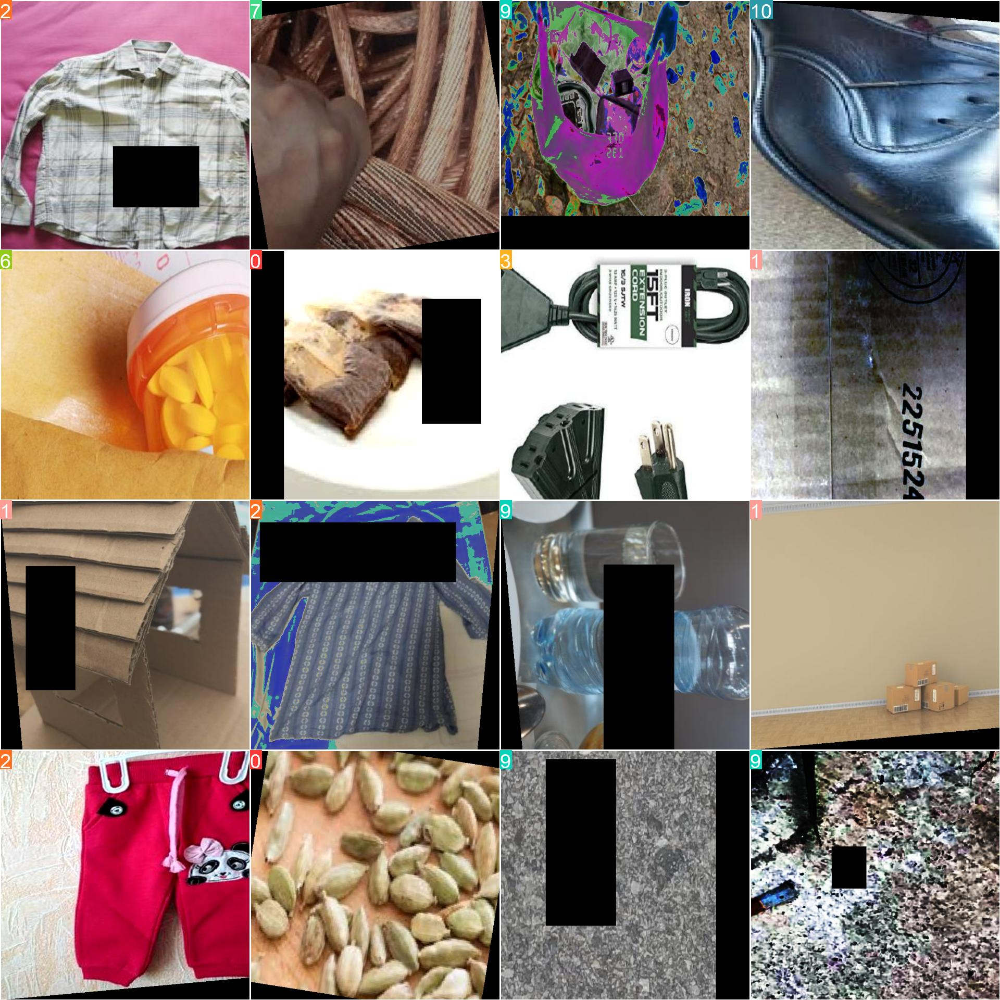

In [ ]:
Image(filename=f'{DATA_DIR}/runs/classify/train2/train_batch1.jpg')

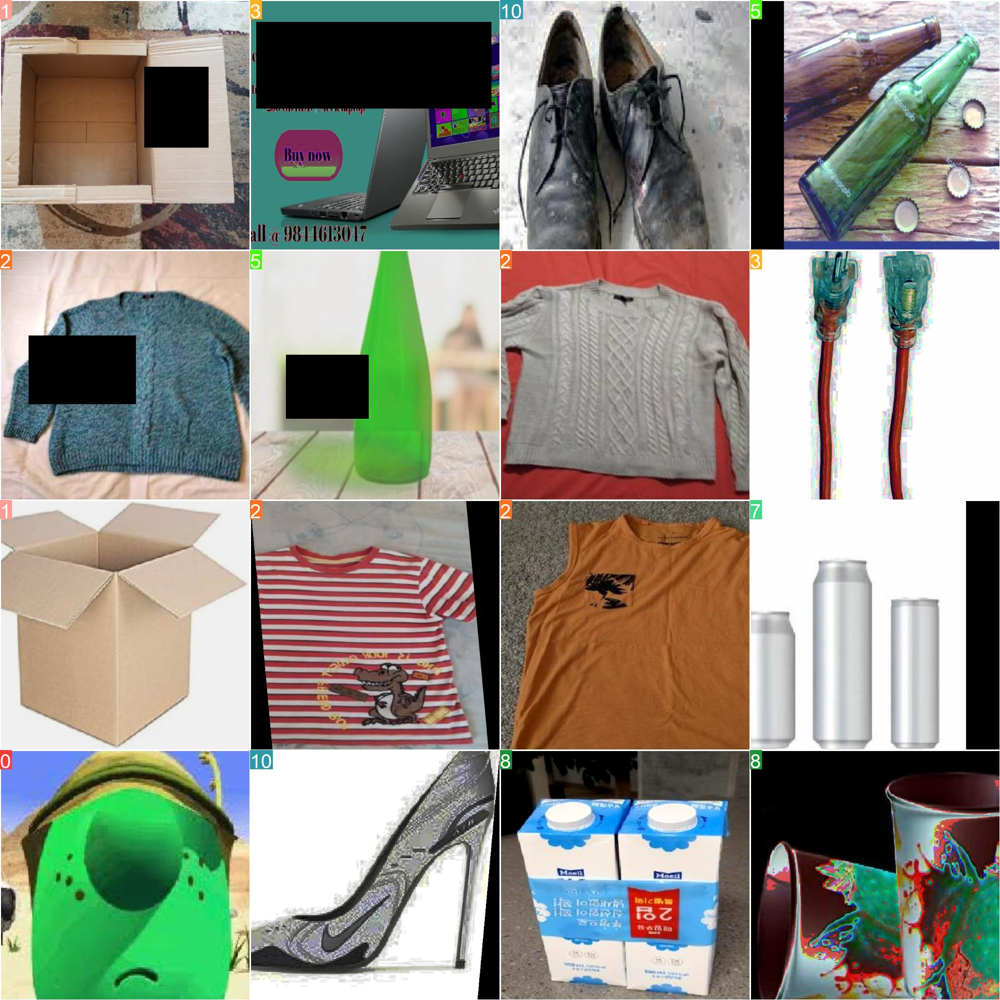

In [ ]:
Image(filename=f'{DATA_DIR}/runs/classify/train2/train_batch2.jpg')

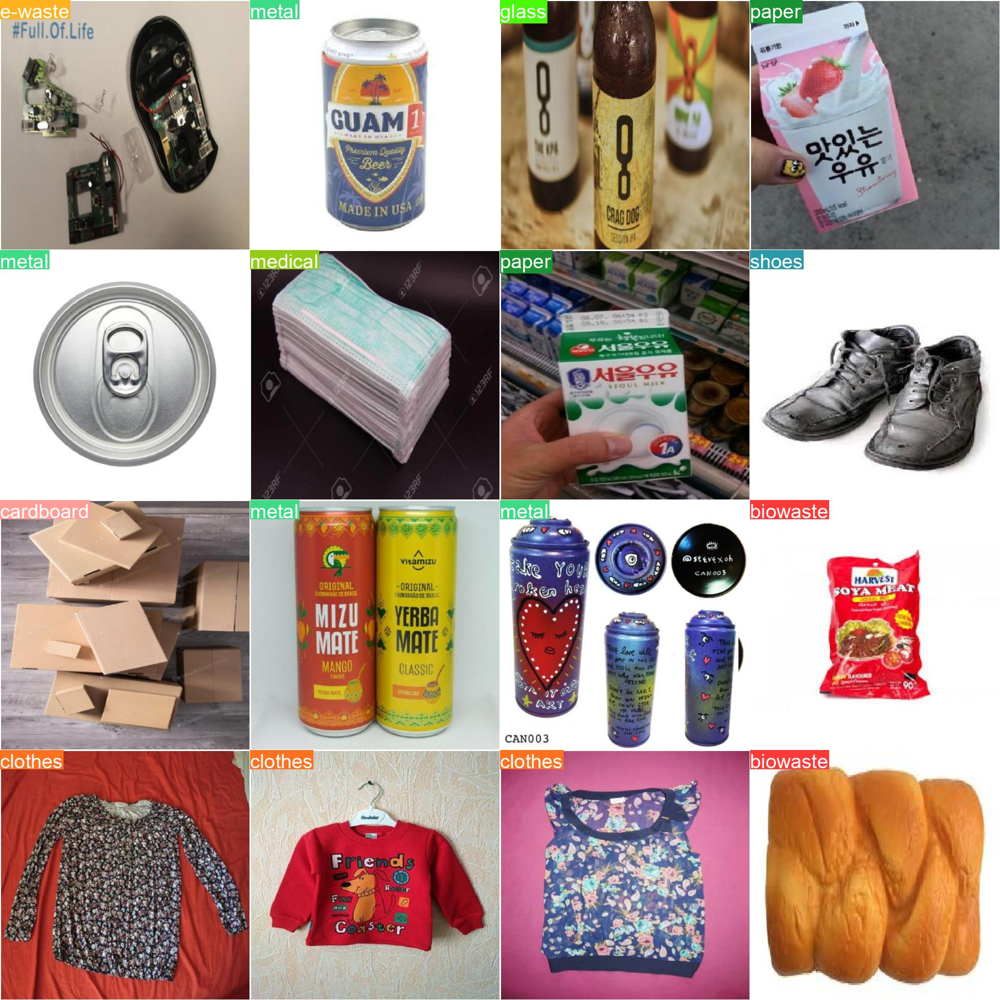

In [ ]:
Image(filename=f'{DATA_DIR}/runs/classify/train2/val_batch0_labels.jpg')

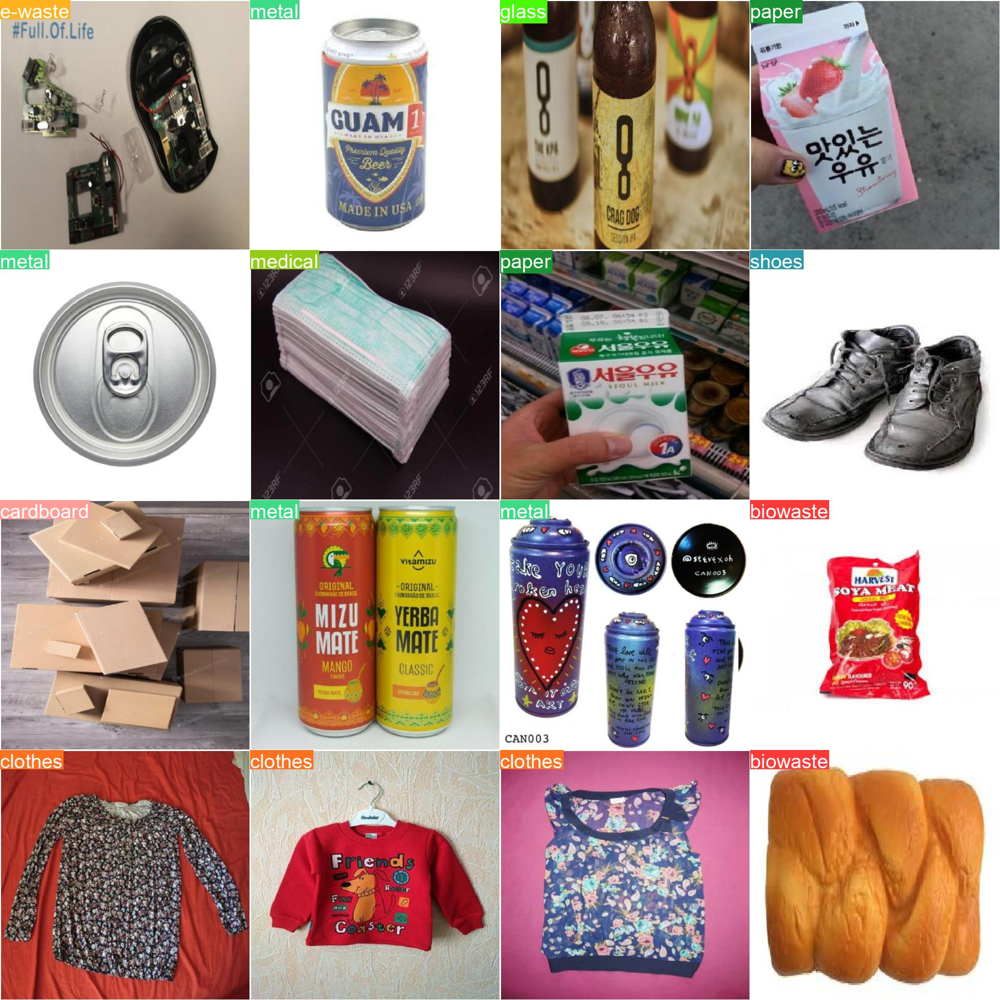

In [ ]:
Image(filename=f'{DATA_DIR}/runs/classify/train2/val_batch0_pred.jpg')

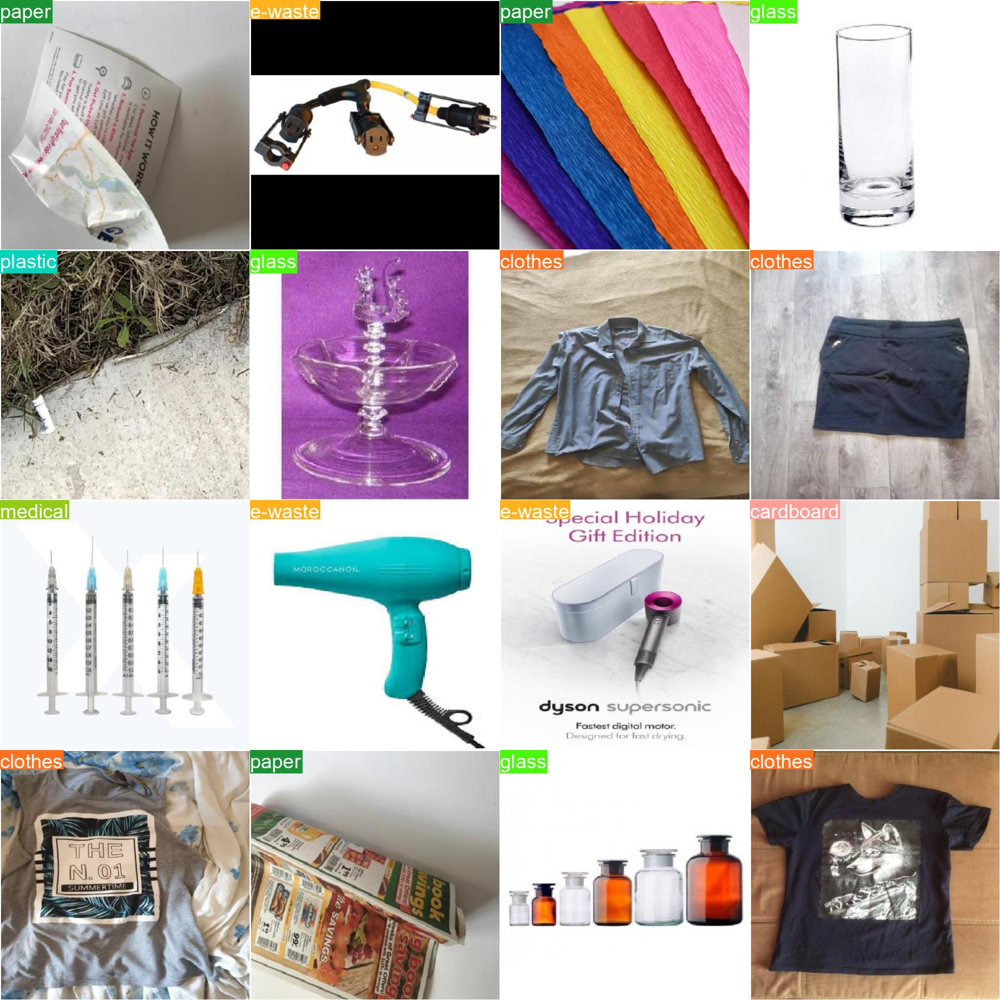

In [ ]:
Image(filename=f'{DATA_DIR}/runs/classify/val3/val_batch2_labels.jpg')

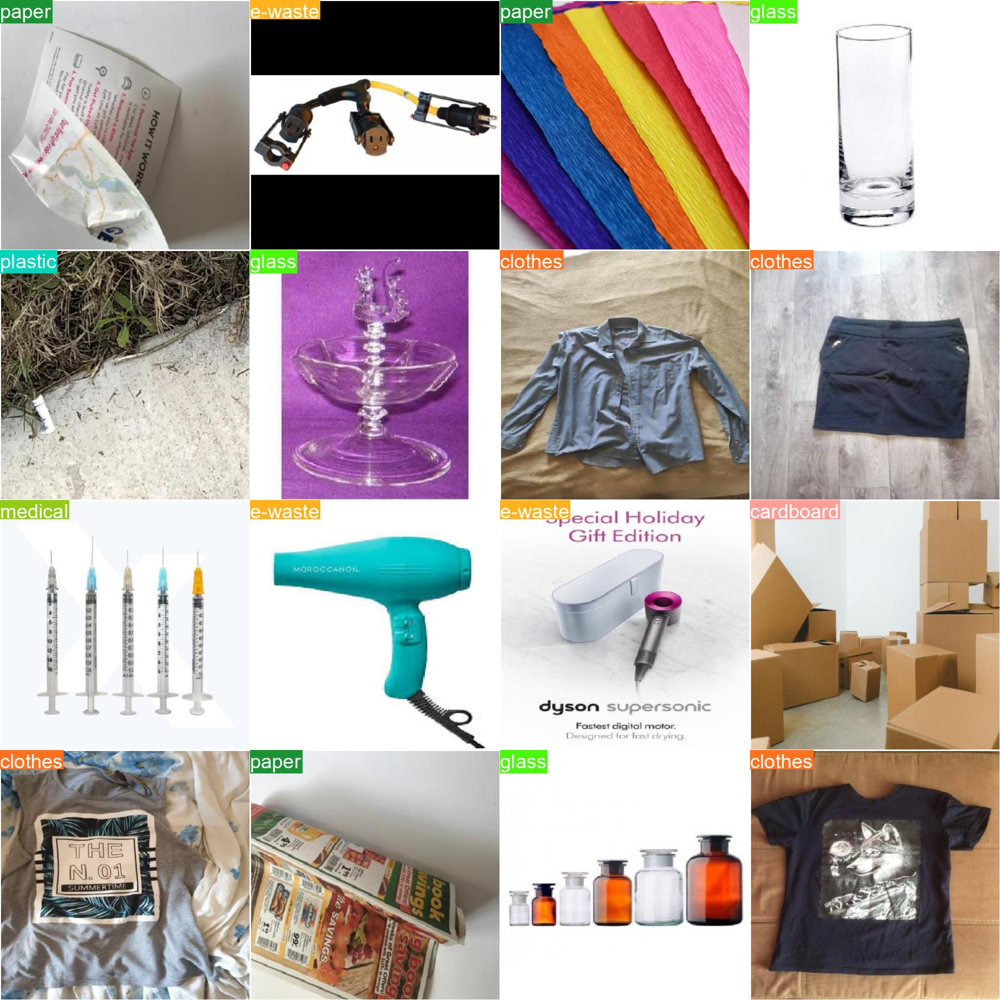

In [ ]:
Image(filename=f'{DATA_DIR}/runs/classify/val3/val_batch2_pred.jpg')

In [ ]:
%cd {HOME}
#!yolo task=classify mode=predict model={HOME}/drive/MyDrive/Data298AandB/data/train_val_test/runs/classify/train/weights/last.pt conf=0.25 source='{HOME}/drive/MyDrive/Data298AandB/data/train_val_test/test/furniture'

In [ ]:
model = YOLO('/content/drive/MyDrive/Data298AandB/Grounding_DINO/YOLO_Classification/data/runs/classify/train2/weights/best.pt')

In [ ]:
from sklearn.metrics import classification_report
from pathlib import Path

# Assuming you have a base path where all class folders are located
base_path = Path('/content/drive/MyDrive/Data298AandB/Grounding_DINO/YOLO_Classification/data/test')

# List of all class folder names (you can also dynamically list them using base_path.glob('*'))
class_folders = ['biowaste', 'cardboard', 'clothes', 'e-waste', 'furniture', 'glass', 'medical', 'metal', 'paper', 'plastic', 'shoes']

# Initialize lists to store true and predicted labels
true_labels = []
predicted_labels = []

# Loop through each class folder and make predictions on each image
for class_folder in class_folders:
  #print('class folder => :', class_folder)

  folder_path = base_path / class_folder
  #print('folder path =>', folder_path)
  # Make predictions on the current folder
  results = model(source=str(folder_path), conf=0.25)

  # Process each result
  for result in results:
    # Get the ground truth from the folder name
    true_labels.append(class_folder)

        # Get the predicted class name using the top1 index
    predicted_class_name = result.names[result.probs.top1]
    print('predicted_class_name =>', predicted_class_name)
    predicted_labels.append(predicted_class_name)

# Now that we have all the true labels and predicted labels, we can calculate the classification report
report = classification_report(true_labels, predicted_labels, target_names=class_folders)
print(report)


image 1/231 /content/drive/MyDrive/Data298AandB/Grounding_DINO/YOLO_Classification/data/test/biowaste/organic_000062_photo.jpg: 640x640 biowaste 1.00, paper 0.00, shoes 0.00, e-waste 0.00, cardboard 0.00, 3.2ms
image 2/231 /content/drive/MyDrive/Data298AandB/Grounding_DINO/YOLO_Classification/data/test/biowaste/organic_000087_photo.jpg: 640x640 biowaste 1.00, shoes 0.00, metal 0.00, plastic 0.00, cardboard 0.00, 3.3ms
image 3/231 /content/drive/MyDrive/Data298AandB/Grounding_DINO/YOLO_Classification/data/test/biowaste/organic_000094_photo.jpg: 640x640 biowaste 1.00, metal 0.00, shoes 0.00, e-waste 0.00, plastic 0.00, 6.6ms
image 4/231 /content/drive/MyDrive/Data298AandB/Grounding_DINO/YOLO_Classification/data/test/biowaste/organic_000117_photo.jpg: 640x640 biowaste 1.00, shoes 0.00, e-waste 0.00, paper 0.00, plastic 0.00, 3.4ms
image 5/231 /content/drive/MyDrive/Data298AandB/Grounding_DINO/YOLO_Classification/data/test/biowaste/organic_000173_photo.jpg: 640x640 biowaste 1.00, medical 

In [ ]:
!ls '{HOME}/runs/classify/predict'

/content/runs/classify/predict/Chairs1--20-_jpg.rf.fd2c79c53946753448a20fddfa3b2b11.jpg


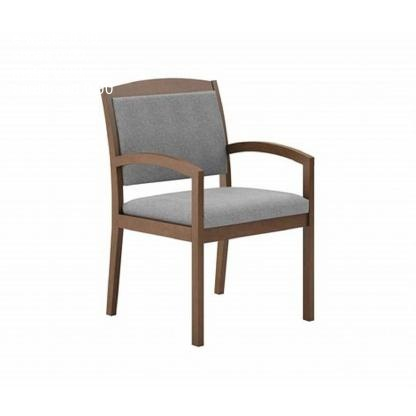



/content/runs/classify/predict/Table--116-_jpg.rf.a74e15afe10e448729543970c01ff5df.jpg


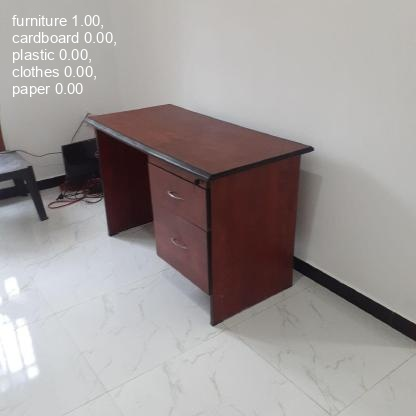



/content/runs/classify/predict/Chair--5-_jpg.rf.68493a0c2f18c18e94687da77df7adeb.jpg


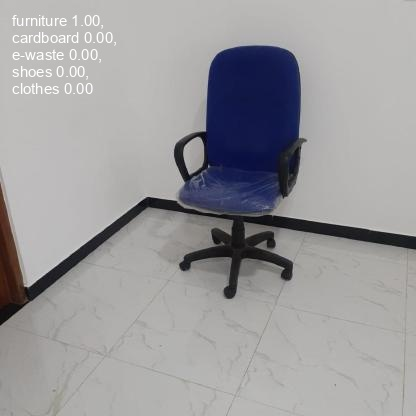



/content/runs/classify/predict/Chairs1--11-_jpg.rf.c6246ee15d4b57b9b05c5ad30e0d1b29.jpg


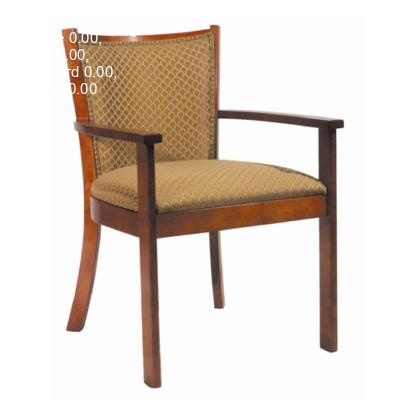



/content/runs/classify/predict/Sofa--175-_jpg.rf.05a2461e0b0a3b210258f318b0cfa30d.jpg


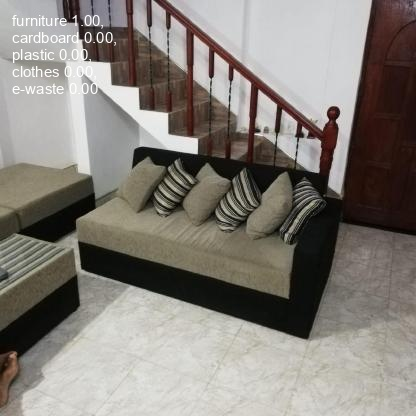



/content/runs/classify/predict/Chairs--19-_jpg.rf.40292689b7fe54a2c3652f887c0f79e0.jpg


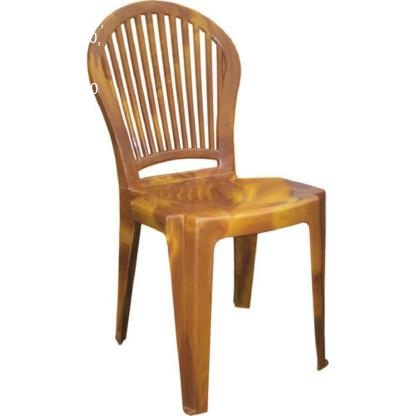



/content/runs/classify/predict/Sofa--215-_jpg.rf.12e63a0876031ef9f366e5cf0d02f52c.jpg


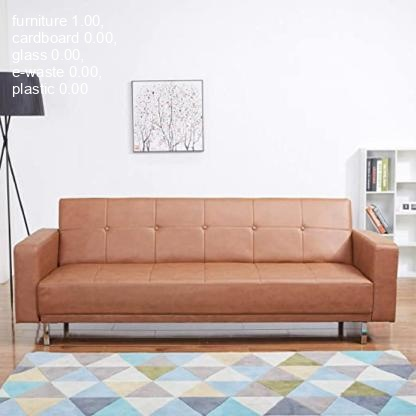



/content/runs/classify/predict/Chair--224-_jpg.rf.709ca65b2e2a4526dacbea4db178f310.jpg


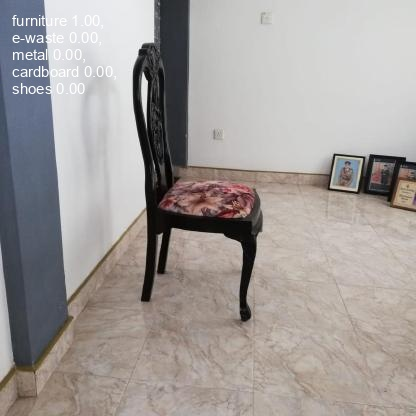



/content/runs/classify/predict/Sofa--172-_jpg.rf.a9e6c352fe7b022d4c8b1ed674d7be6d.jpg


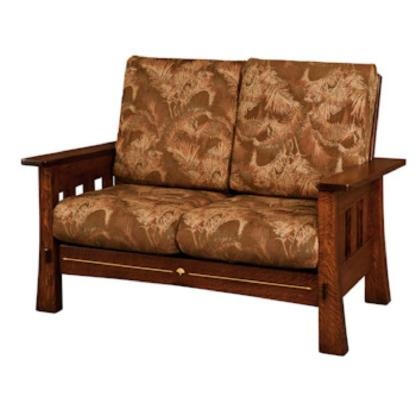



/content/runs/classify/predict/Sofa--210-_jpg.rf.765d537fdc4001d529057077ed99b71d.jpg


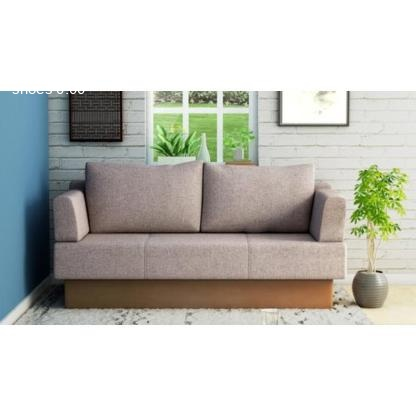

In [ ]:
#from ultralytics.models.rtdetr import predict
import glob
from IPython.display import Image,display

for image_path in glob.glob(f'{HOME}/runs/classify/predict/*.jpg')[:10]:
  print(image_path)
  display(Image(filename=image_path, height = 416))
  print('\n')

In [ ]:
%cd {HOME}
!yolo task=classify mode=predict model={HOME}/drive/MyDrive/Data298AandB/data/train_val_test/runs/classify/train/weights/last.pt conf=0.25 source='{HOME}/drive/MyDrive/Data298AandB/data/train_val_test/test/plastic'

/content
Ultralytics YOLOv8.0.208 🚀 Python-3.10.12 torch-2.1.0+cu118 CUDA:0 (Tesla V100-SXM2-16GB, 16151MiB)
YOLOv8s-cls summary (fused): 73 layers, 5089291 parameters, 0 gradients, 12.5 GFLOPs

image 1/189 /content/drive/MyDrive/Data298AandB/data/train_val_test/test/plastic/plastic 1000.jpg: 416x416 plastic 1.00, glass 0.00, cardboard 0.00, medical 0.00, furniture 0.00, 3.4ms
image 2/189 /content/drive/MyDrive/Data298AandB/data/train_val_test/test/plastic/plastic 1027.jpg: 416x416 plastic 1.00, glass 0.00, medical 0.00, metal 0.00, biowaste 0.00, 4.0ms
image 3/189 /content/drive/MyDrive/Data298AandB/data/train_val_test/test/plastic/plastic 104.jpg: 416x416 plastic 1.00, cardboard 0.00, paper 0.00, glass 0.00, metal 0.00, 3.8ms
image 4/189 /content/drive/MyDrive/Data298AandB/data/train_val_test/test/plastic/plastic 1040.jpg: 416x416 plastic 1.00, medical 0.00, paper 0.00, metal 0.00, glass 0.00, 3.6ms
image 5/189 /content/drive/MyDrive/Data298AandB/data/train_val_test/test/plastic/plas

/content/runs/classify/predict2/plastic 2631.jpg


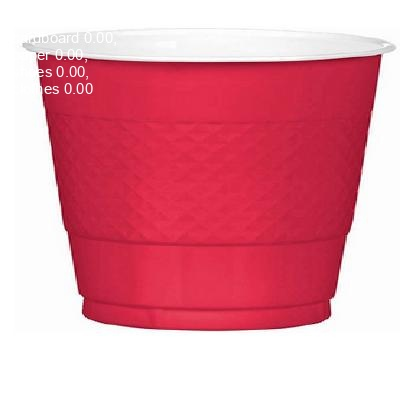



/content/runs/classify/predict2/plastic 238.jpg


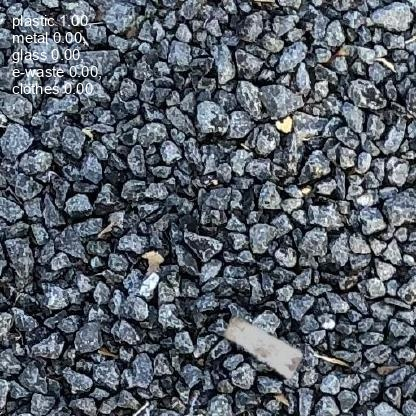



/content/runs/classify/predict2/plastic 681.jpg


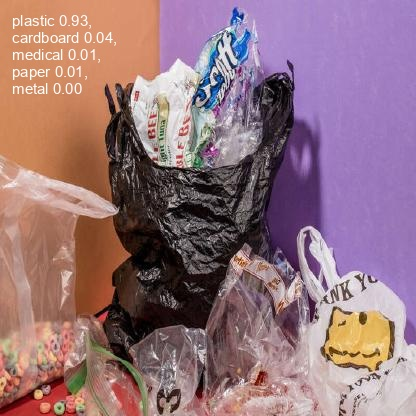



/content/runs/classify/predict2/plastic 1182.jpg


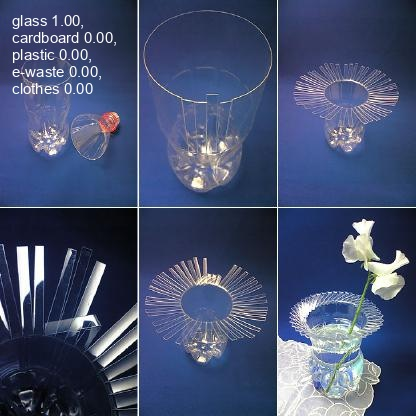



/content/runs/classify/predict2/plastic 2152.jpg


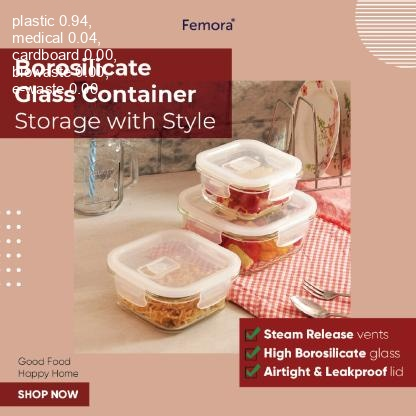



/content/runs/classify/predict2/plastic 1861.jpg


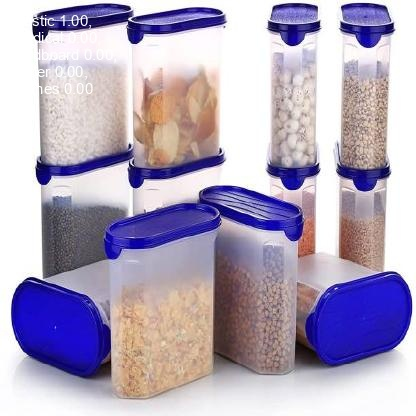



/content/runs/classify/predict2/plastic 1104.jpg


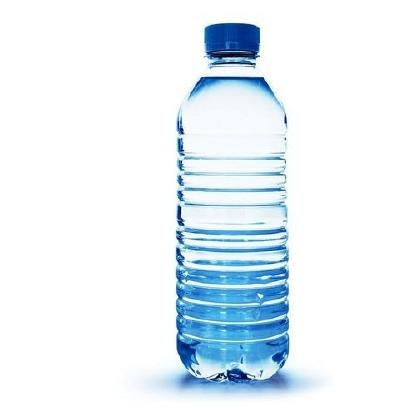



/content/runs/classify/predict2/plastic 638.jpg


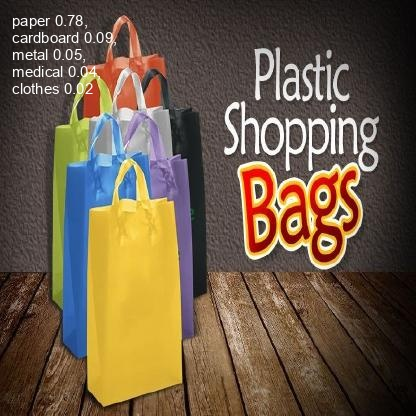



/content/runs/classify/predict2/plastic 319.jpg


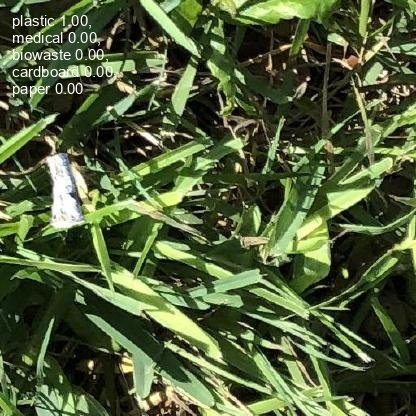



/content/runs/classify/predict2/plastic 1577.jpg


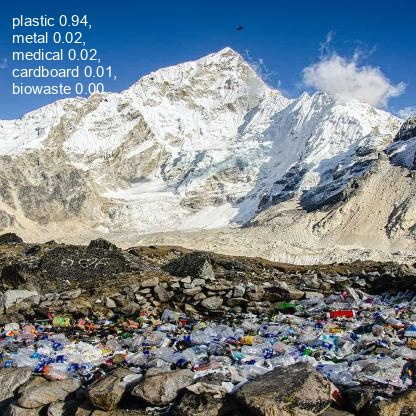

In [ ]:
#from ultralytics.models.rtdetr import predict
import glob
from IPython.display import Image,display

for image_path in glob.glob(f'{HOME}/runs/classify/predict2/*.jpg')[:10]:
  print(image_path)
  display(Image(filename=image_path, height = 416))
  print('\n')

In [ ]:
!yolo task=classify mode=predict model={HOME}/drive/MyDrive/Data298AandB/data/train_val_test/runs/classify/train/weights/last.pt conf=0.25 source='{HOME}/drive/MyDrive/Data298AandB/data/train_val_test/test/biowaste'

Ultralytics YOLOv8.0.208 🚀 Python-3.10.12 torch-2.1.0+cu118 CUDA:0 (Tesla V100-SXM2-16GB, 16151MiB)
YOLOv8s-cls summary (fused): 73 layers, 5089291 parameters, 0 gradients, 12.5 GFLOPs

image 1/231 /content/drive/MyDrive/Data298AandB/data/train_val_test/test/biowaste/organic_000062_photo.jpg: 416x416 biowaste 1.00, paper 0.00, cardboard 0.00, e-waste 0.00, shoes 0.00, 3.0ms
image 2/231 /content/drive/MyDrive/Data298AandB/data/train_val_test/test/biowaste/organic_000087_photo.jpg: 416x416 biowaste 1.00, shoes 0.00, metal 0.00, plastic 0.00, cardboard 0.00, 3.6ms
image 3/231 /content/drive/MyDrive/Data298AandB/data/train_val_test/test/biowaste/organic_000094_photo.jpg: 416x416 biowaste 1.00, shoes 0.00, metal 0.00, e-waste 0.00, clothes 0.00, 3.4ms
image 4/231 /content/drive/MyDrive/Data298AandB/data/train_val_test/test/biowaste/organic_000117_photo.jpg: 416x416 biowaste 1.00, paper 0.00, medical 0.00, clothes 0.00, e-waste 0.00, 3.4ms
image 5/231 /content/drive/MyDrive/Data298AandB/data

/content/runs/classify/predict3/organic_005340_photo.jpg


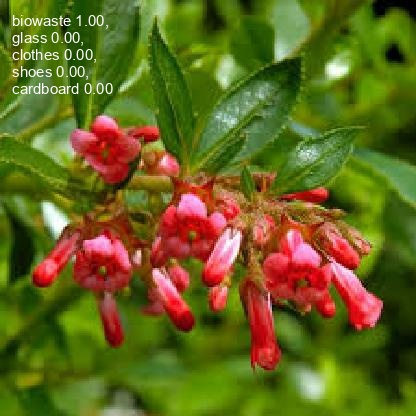



/content/runs/classify/predict3/organic_000619_photo.jpg


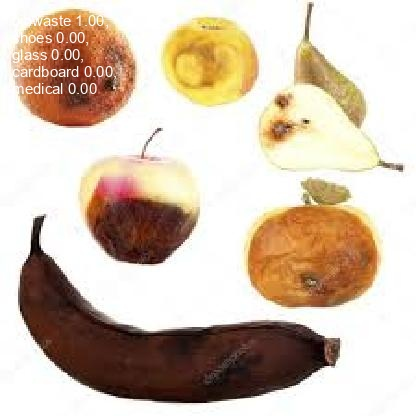



/content/runs/classify/predict3/organic_001280_photo.jpg


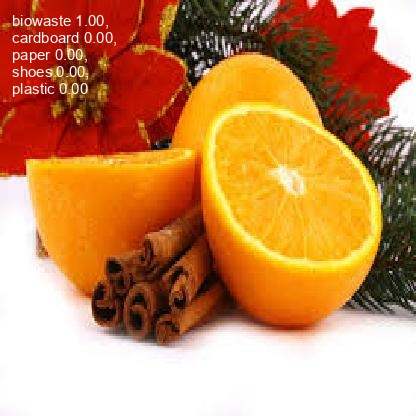



/content/runs/classify/predict3/organic_013947_photo.jpg


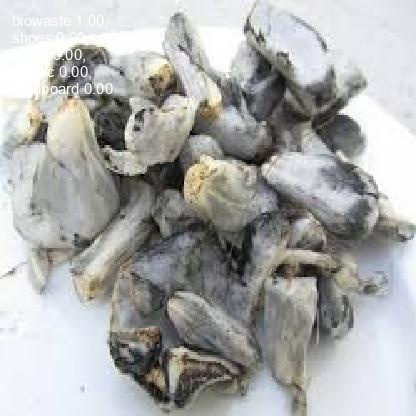



/content/runs/classify/predict3/organic_005394_photo.jpg


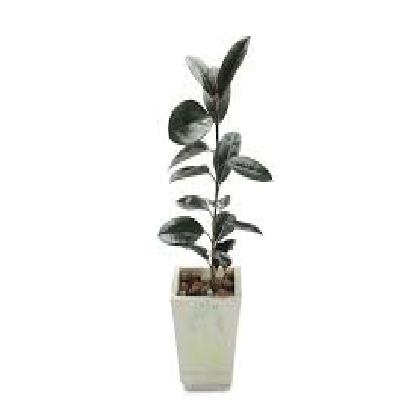



/content/runs/classify/predict3/organic_000298_photo.jpg


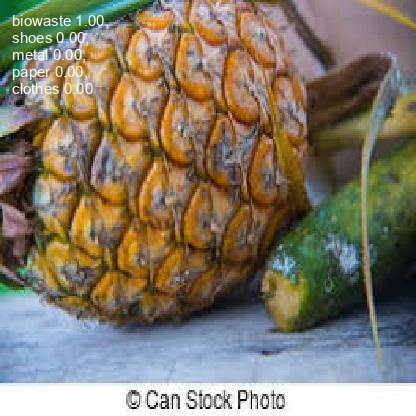



/content/runs/classify/predict3/organic_009975_photo.jpg


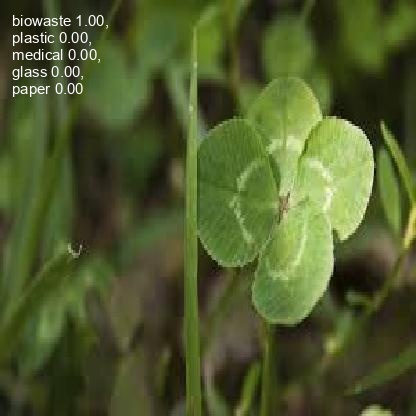



/content/runs/classify/predict3/organic_009558_photo.jpg


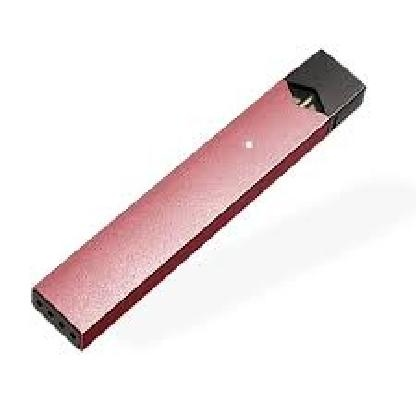



/content/runs/classify/predict3/organic_009849_photo.jpg


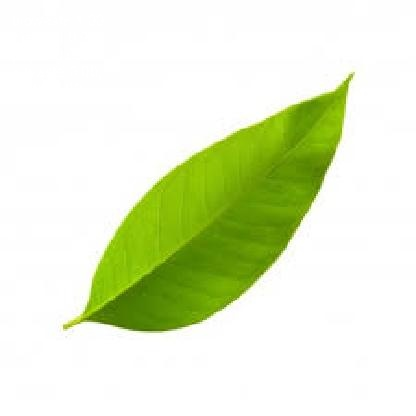



/content/runs/classify/predict3/organic_013508_photo.jpg


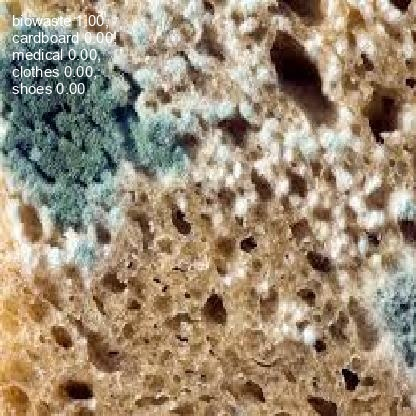

In [ ]:
#from ultralytics.models.rtdetr import predict
import glob
from IPython.display import Image,display

for image_path in glob.glob(f'{HOME}/runs/classify/predict3/*.jpg')[:10]:
  print(image_path)
  display(Image(filename=image_path, height = 416))
  print('\n')

In [ ]:
!yolo task=classify mode=predict model={HOME}/drive/MyDrive/Data298AandB/data/train_val_test/runs/classify/train/weights/last.pt conf=0.25 source='{HOME}/drive/MyDrive/Data298AandB/data/train_val_test/test/glass'

Ultralytics YOLOv8.0.208 🚀 Python-3.10.12 torch-2.1.0+cu118 CUDA:0 (Tesla V100-SXM2-16GB, 16151MiB)
YOLOv8s-cls summary (fused): 73 layers, 5089291 parameters, 0 gradients, 12.5 GFLOPs

image 1/169 /content/drive/MyDrive/Data298AandB/data/train_val_test/test/glass/glass 1001.jpg: 416x416 glass 0.98, e-waste 0.02, paper 0.00, cardboard 0.00, biowaste 0.00, 3.3ms
image 2/169 /content/drive/MyDrive/Data298AandB/data/train_val_test/test/glass/glass 1014.jpg: 416x416 glass 1.00, plastic 0.00, e-waste 0.00, biowaste 0.00, clothes 0.00, 5.7ms
image 3/169 /content/drive/MyDrive/Data298AandB/data/train_val_test/test/glass/glass 1017.jpg: 416x416 glass 0.86, paper 0.10, cardboard 0.03, plastic 0.01, furniture 0.00, 3.5ms
image 4/169 /content/drive/MyDrive/Data298AandB/data/train_val_test/test/glass/glass 1025.jpg: 416x416 glass 1.00, plastic 0.00, medical 0.00, metal 0.00, paper 0.00, 3.4ms
image 5/169 /content/drive/MyDrive/Data298AandB/data/train_val_test/test/glass/glass 1034.jpg: 416x416 gla

/content/runs/classify/predict4/glass 2220.jpg


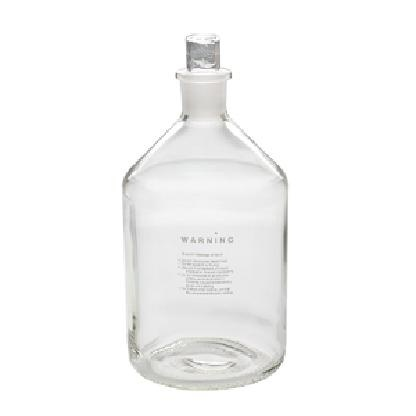



/content/runs/classify/predict4/glass 2258.jpg


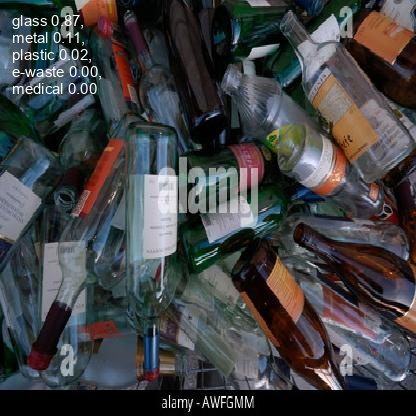



/content/runs/classify/predict4/glass 1223.jpg


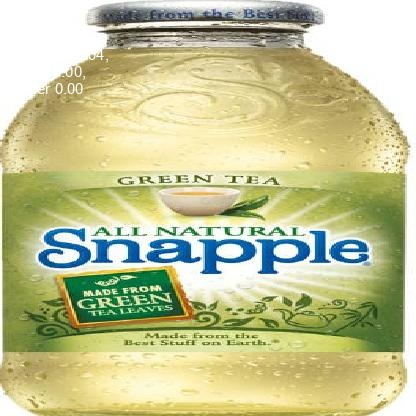



/content/runs/classify/predict4/glass 2262.jpg


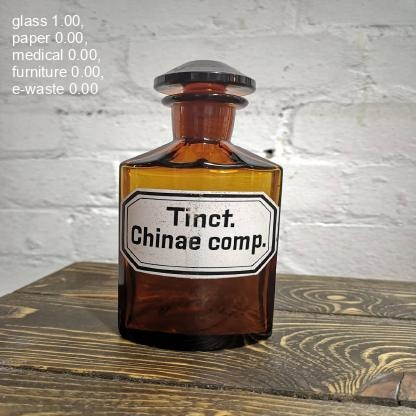



/content/runs/classify/predict4/glass 1459.jpg


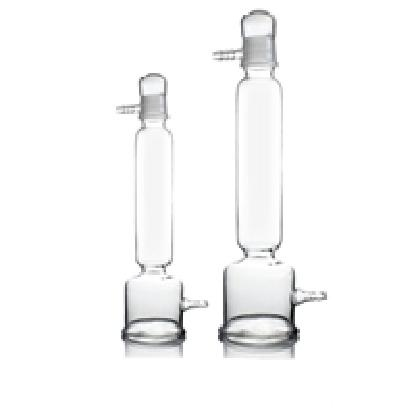



/content/runs/classify/predict4/glass 780.jpg


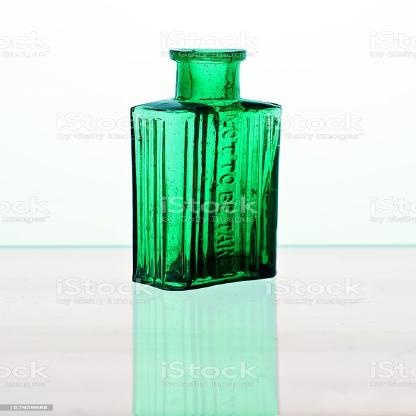



/content/runs/classify/predict4/glass 2282.jpg


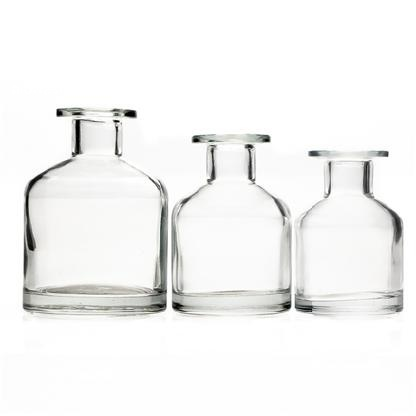



/content/runs/classify/predict4/glass 1014.jpg


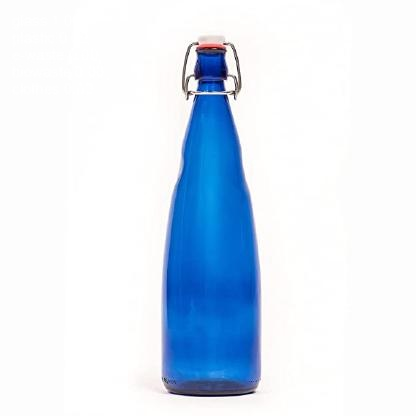



/content/runs/classify/predict4/glass 7.jpg


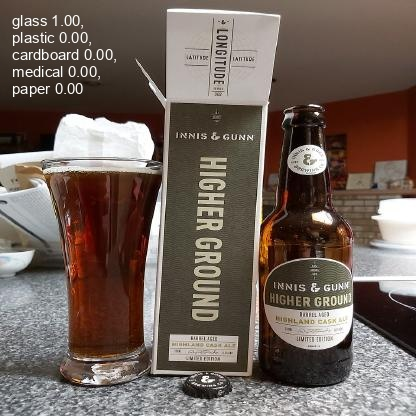



/content/runs/classify/predict4/glass 1744.jpg


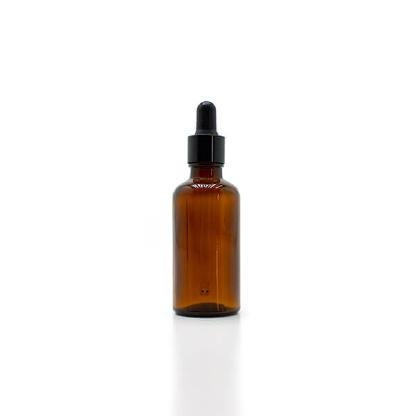

In [ ]:
#from ultralytics.models.rtdetr import predict
import glob
from IPython.display import Image,display

for image_path in glob.glob(f'{HOME}/runs/classify/predict4/*.jpg')[:10]:
  print(image_path)
  display(Image(filename=image_path, height = 416))
  print('\n')

In [ ]:
!yolo task=classify mode=predict model={HOME}/drive/MyDrive/Data298AandB/data/train_val_test/runs/classify/train/weights/last.pt conf=0.25 source='{HOME}/drive/MyDrive/Data298AandB/data/train_val_test/test/clothes'

Ultralytics YOLOv8.0.208 🚀 Python-3.10.12 torch-2.1.0+cu118 CUDA:0 (Tesla V100-SXM2-16GB, 16151MiB)
YOLOv8s-cls summary (fused): 73 layers, 5089291 parameters, 0 gradients, 12.5 GFLOPs

image 1/250 /content/drive/MyDrive/Data298AandB/data/train_val_test/test/clothes/clothes100.jpg: 416x416 clothes 1.00, e-waste 0.00, biowaste 0.00, paper 0.00, cardboard 0.00, 3.5ms
image 2/250 /content/drive/MyDrive/Data298AandB/data/train_val_test/test/clothes/clothes1029.jpg: 416x416 clothes 1.00, cardboard 0.00, shoes 0.00, e-waste 0.00, medical 0.00, 4.0ms
image 3/250 /content/drive/MyDrive/Data298AandB/data/train_val_test/test/clothes/clothes1046.jpg: 416x416 clothes 1.00, plastic 0.00, cardboard 0.00, furniture 0.00, e-waste 0.00, 3.8ms
image 4/250 /content/drive/MyDrive/Data298AandB/data/train_val_test/test/clothes/clothes1099.jpg: 416x416 clothes 1.00, cardboard 0.00, medical 0.00, e-waste 0.00, metal 0.00, 3.4ms
image 5/250 /content/drive/MyDrive/Data298AandB/data/train_val_test/test/clothes/c

/content/runs/classify/predict5/clothes3644.jpg


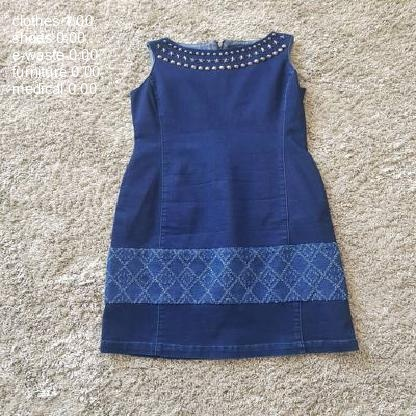



/content/runs/classify/predict5/clothes5086.jpg


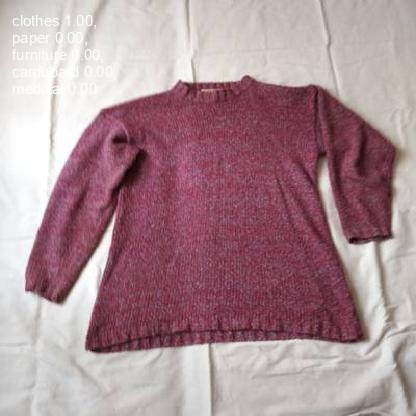



/content/runs/classify/predict5/clothes4380.jpg


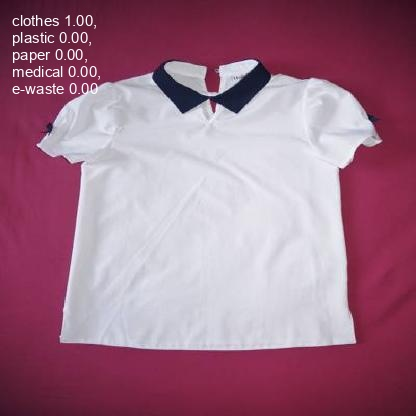



/content/runs/classify/predict5/clothes207.jpg


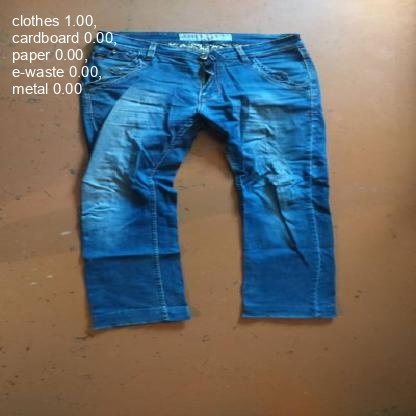



/content/runs/classify/predict5/clothes1046.jpg


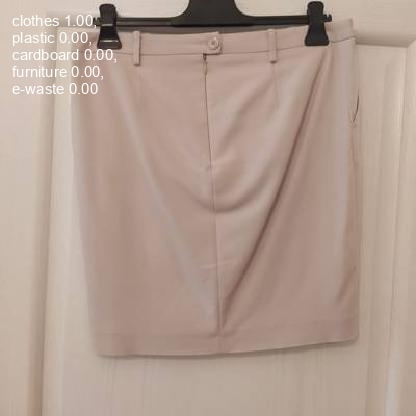



/content/runs/classify/predict5/clothes159.jpg


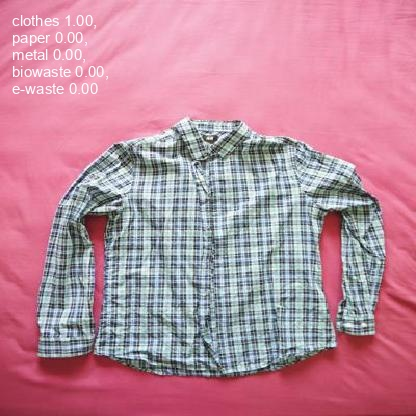



/content/runs/classify/predict5/clothes2688.jpg


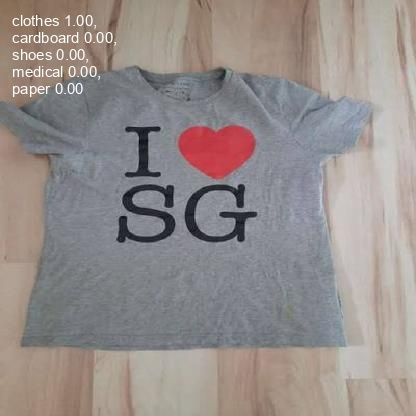



/content/runs/classify/predict5/clothes4849.jpg


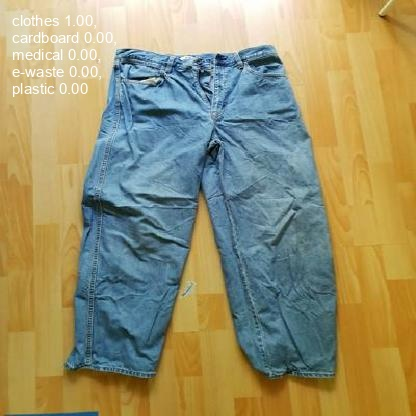



/content/runs/classify/predict5/clothes2562.jpg


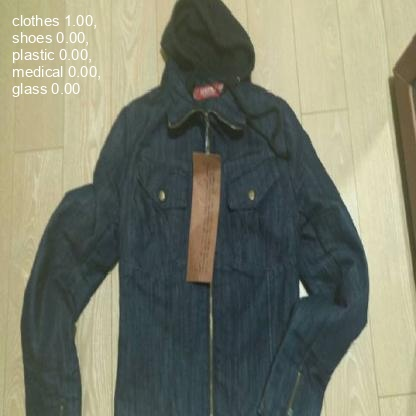



/content/runs/classify/predict5/clothes5211.jpg


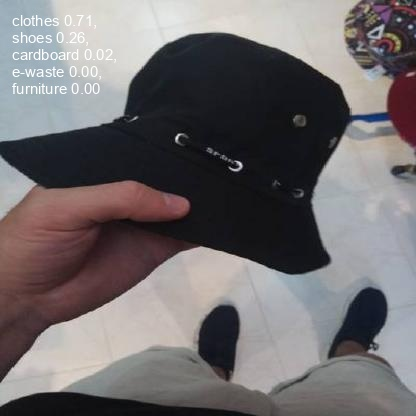

In [ ]:
for image_path in glob.glob(f'{HOME}/runs/classify/predict5/*.jpg')[:10]:
  print(image_path)
  display(Image(filename=image_path, height = 416))
  print('\n')

In [ ]:
!yolo task=classify mode=predict model={HOME}/drive/MyDrive/Data298AandB/data/train_val_test/runs/classify/train/weights/last.pt conf=0.25 source='{HOME}/drive/MyDrive/Data298AandB/data/train_val_test/test/shoes'

Ultralytics YOLOv8.0.208 🚀 Python-3.10.12 torch-2.1.0+cu118 CUDA:0 (Tesla V100-SXM2-16GB, 16151MiB)
YOLOv8s-cls summary (fused): 73 layers, 5089291 parameters, 0 gradients, 12.5 GFLOPs

image 1/197 /content/drive/MyDrive/Data298AandB/data/train_val_test/test/shoes/shoes100.jpg: 416x416 shoes 1.00, e-waste 0.00, biowaste 0.00, clothes 0.00, furniture 0.00, 3.9ms
image 2/197 /content/drive/MyDrive/Data298AandB/data/train_val_test/test/shoes/shoes1001.jpg: 416x416 shoes 1.00, biowaste 0.00, e-waste 0.00, metal 0.00, clothes 0.00, 6.5ms
image 3/197 /content/drive/MyDrive/Data298AandB/data/train_val_test/test/shoes/shoes1002.jpg: 416x416 shoes 1.00, biowaste 0.00, cardboard 0.00, medical 0.00, paper 0.00, 3.5ms
image 4/197 /content/drive/MyDrive/Data298AandB/data/train_val_test/test/shoes/shoes1017.jpg: 416x416 shoes 1.00, biowaste 0.00, e-waste 0.00, glass 0.00, cardboard 0.00, 3.3ms
image 5/197 /content/drive/MyDrive/Data298AandB/data/train_val_test/test/shoes/shoes1026.jpg: 416x416 shoes

/content/runs/classify/predict6/shoes220.jpg


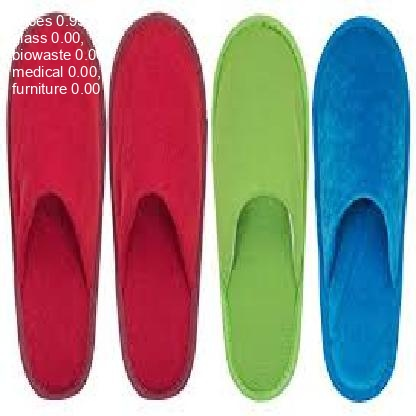



/content/runs/classify/predict6/shoes745.jpg


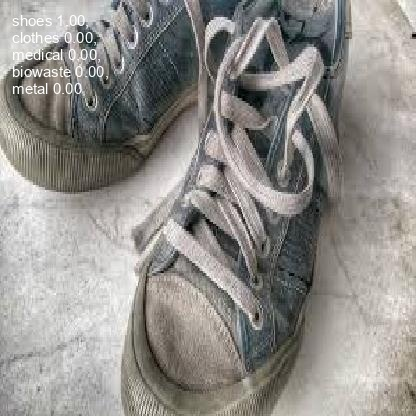



/content/runs/classify/predict6/shoes423.jpg


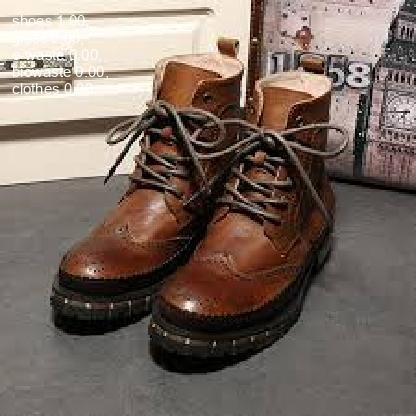



/content/runs/classify/predict6/shoes1290.jpg


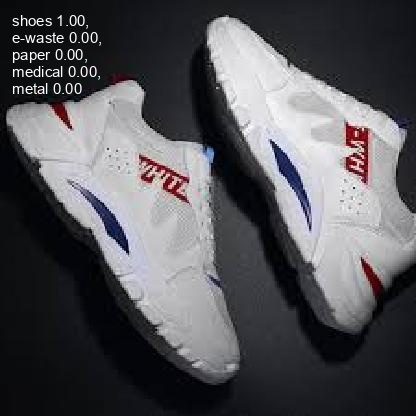



/content/runs/classify/predict6/shoes555.jpg


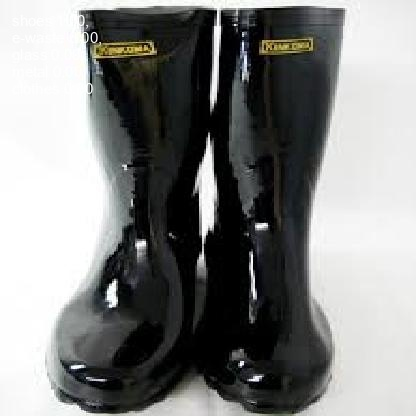



/content/runs/classify/predict6/shoes1893.jpg


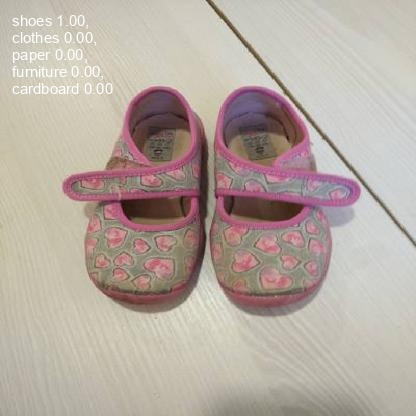



/content/runs/classify/predict6/shoes1640.jpg


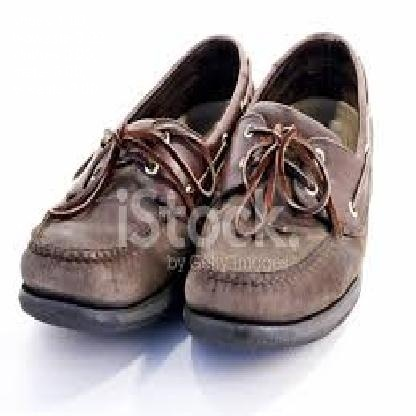



/content/runs/classify/predict6/shoes739.jpg


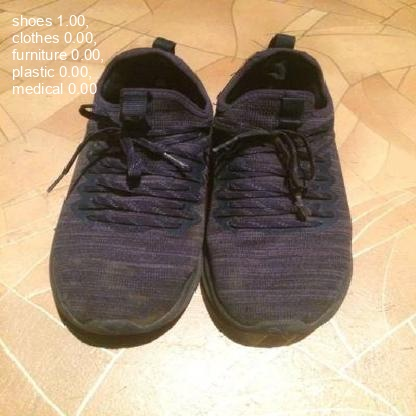



/content/runs/classify/predict6/shoes1576.jpg


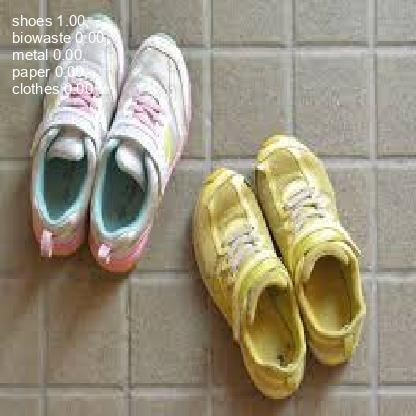



/content/runs/classify/predict6/shoes1823.jpg


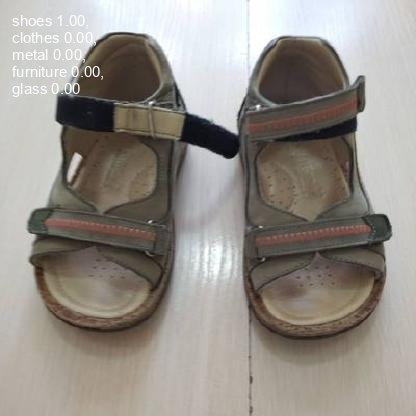

In [ ]:
for image_path in glob.glob(f'{HOME}/runs/classify/predict6/*.jpg')[:10]:
  print(image_path)
  display(Image(filename=image_path, height = 416))
  print('\n')

In [ ]:
!yolo task=classify mode=predict model={HOME}/drive/MyDrive/Data298AandB/data/train_val_test/runs/classify/train/weights/last.pt conf=0.25 source='{HOME}/drive/MyDrive/Data298AandB/data/train_val_test/test/medical'

Ultralytics YOLOv8.0.208 🚀 Python-3.10.12 torch-2.1.0+cu118 CUDA:0 (Tesla V100-SXM2-16GB, 16151MiB)
YOLOv8s-cls summary (fused): 73 layers, 5089291 parameters, 0 gradients, 12.5 GFLOPs

image 1/139 /content/drive/MyDrive/Data298AandB/data/train_val_test/test/medical/medical 1013.jpg: 416x416 medical 1.00, biowaste 0.00, e-waste 0.00, cardboard 0.00, glass 0.00, 4.6ms
image 2/139 /content/drive/MyDrive/Data298AandB/data/train_val_test/test/medical/medical 1034.jpg: 416x416 medical 1.00, cardboard 0.00, glass 0.00, e-waste 0.00, furniture 0.00, 4.2ms
image 3/139 /content/drive/MyDrive/Data298AandB/data/train_val_test/test/medical/medical 1050.jpg: 416x416 paper 0.50, biowaste 0.19, plastic 0.17, medical 0.09, e-waste 0.03, 3.5ms
image 4/139 /content/drive/MyDrive/Data298AandB/data/train_val_test/test/medical/medical 1054.jpg: 416x416 medical 1.00, e-waste 0.00, biowaste 0.00, metal 0.00, paper 0.00, 3.5ms
image 5/139 /content/drive/MyDrive/Data298AandB/data/train_val_test/test/medical/me

/content/runs/classify/predict7/medical 600.jpg


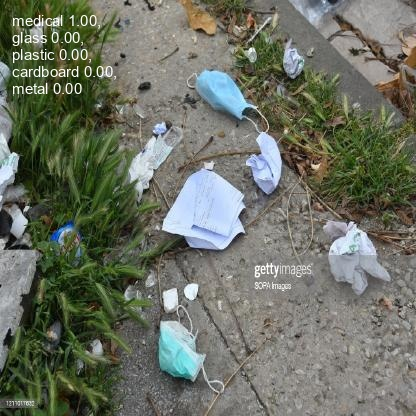



/content/runs/classify/predict7/medical 247.jpg


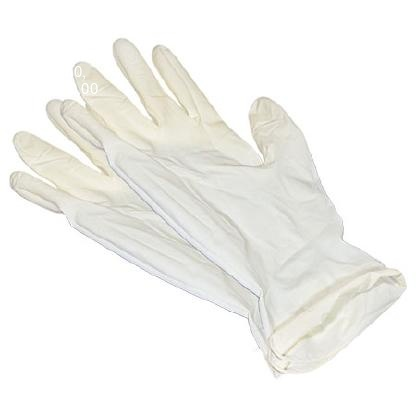



/content/runs/classify/predict7/medical 1702.jpg


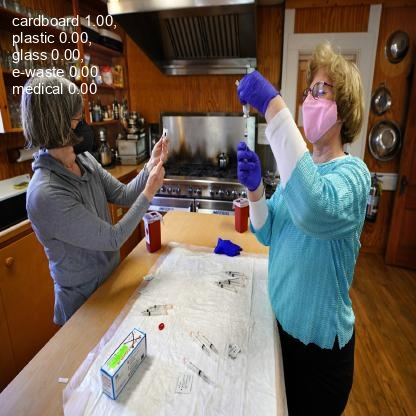



/content/runs/classify/predict7/medical 324.jpg


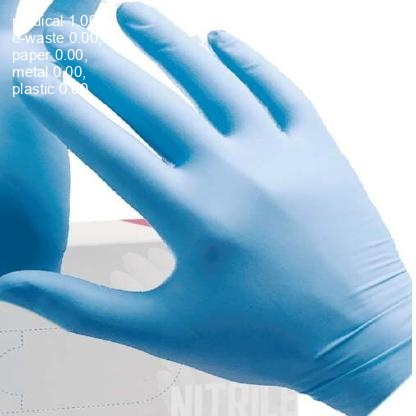



/content/runs/classify/predict7/medical 752.jpg


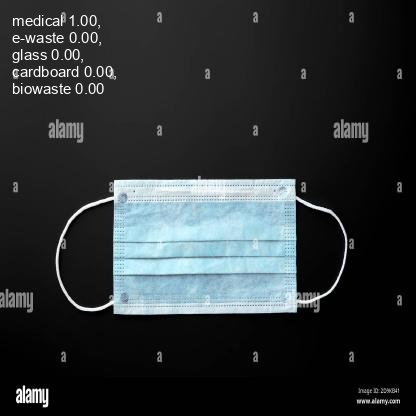



/content/runs/classify/predict7/medical 844.jpg


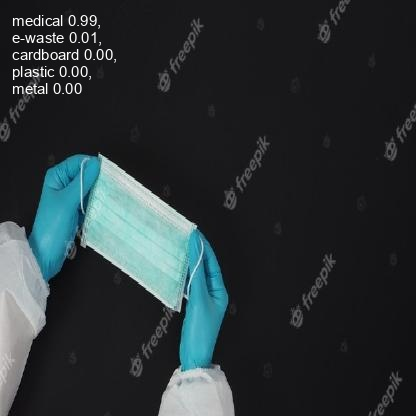



/content/runs/classify/predict7/medical 1698.jpg


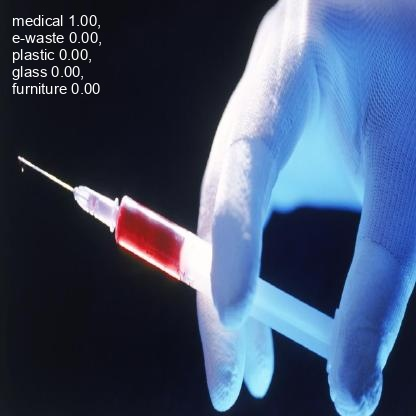



/content/runs/classify/predict7/medical 676.jpg


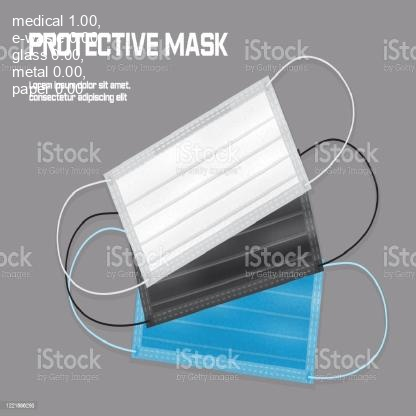



/content/runs/classify/predict7/medical 1179.jpg


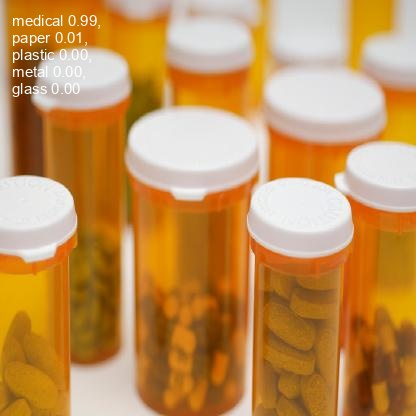



/content/runs/classify/predict7/medical 1472.jpg


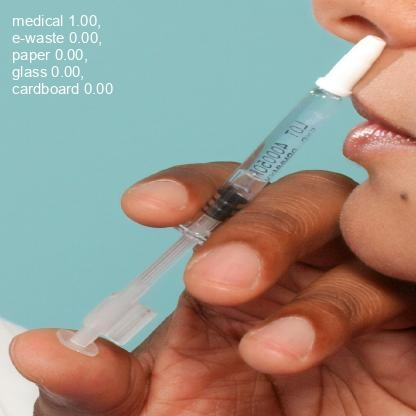

In [ ]:
for image_path in glob.glob(f'{HOME}/runs/classify/predict7/*.jpg')[:10]:
  print(image_path)
  display(Image(filename=image_path, height = 416))
  print('\n')

In [ ]:
!yolo task=classify mode=predict model={HOME}/drive/MyDrive/Data298AandB/data/train_val_test/runs/classify/train/weights/last.pt conf=0.25 source='{HOME}/drive/MyDrive/Data298AandB/data/train_val_test/test/e-waste'

Ultralytics YOLOv8.0.208 🚀 Python-3.10.12 torch-2.1.0+cu118 CUDA:0 (Tesla V100-SXM2-16GB, 16151MiB)
YOLOv8s-cls summary (fused): 73 layers, 5089291 parameters, 0 gradients, 12.5 GFLOPs

image 1/214 /content/drive/MyDrive/Data298AandB/data/train_val_test/test/e-waste/e-waste 1006.jpg: 416x416 paper 0.70, e-waste 0.19, cardboard 0.08, metal 0.02, biowaste 0.01, 4.2ms
image 2/214 /content/drive/MyDrive/Data298AandB/data/train_val_test/test/e-waste/e-waste 1020.jpg: 416x416 e-waste 1.00, glass 0.00, shoes 0.00, metal 0.00, medical 0.00, 4.1ms
image 3/214 /content/drive/MyDrive/Data298AandB/data/train_val_test/test/e-waste/e-waste 1024.jpg: 416x416 e-waste 1.00, paper 0.00, shoes 0.00, plastic 0.00, cardboard 0.00, 5.7ms
image 4/214 /content/drive/MyDrive/Data298AandB/data/train_val_test/test/e-waste/e-waste 1026.jpg: 416x416 e-waste 1.00, glass 0.00, metal 0.00, cardboard 0.00, paper 0.00, 4.7ms
image 5/214 /content/drive/MyDrive/Data298AandB/data/train_val_test/test/e-waste/e-waste 1047.j

/content/runs/classify/predict8/e-waste 2180.jpg


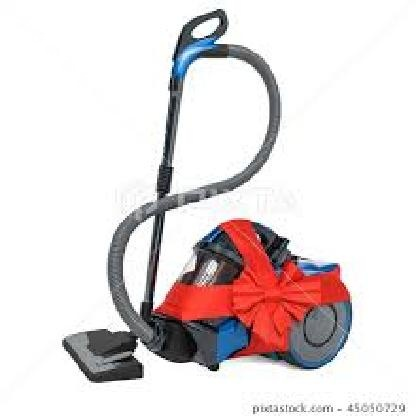



/content/runs/classify/predict8/e-waste 731.jpg


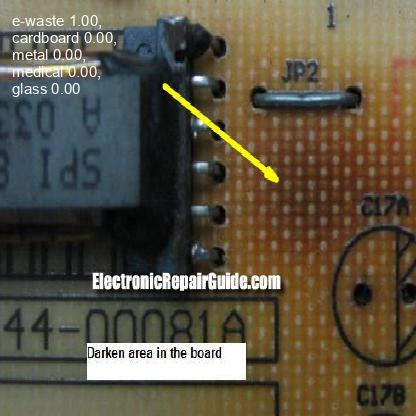



/content/runs/classify/predict8/e-waste 1603.jpg


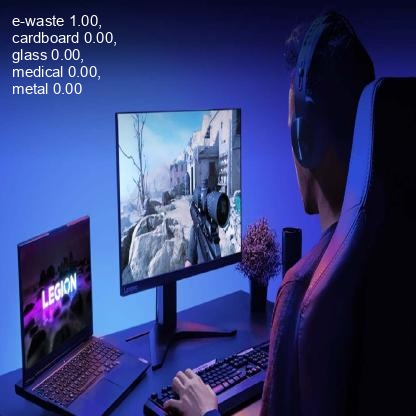



/content/runs/classify/predict8/e-waste 132.jpg


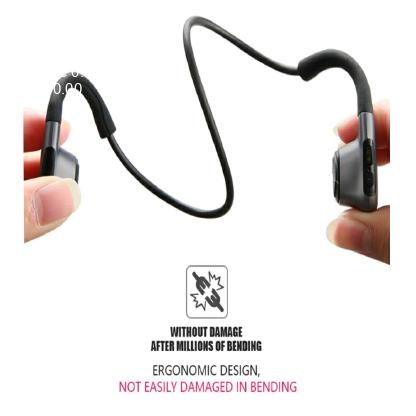



/content/runs/classify/predict8/e-waste 2962.jpg


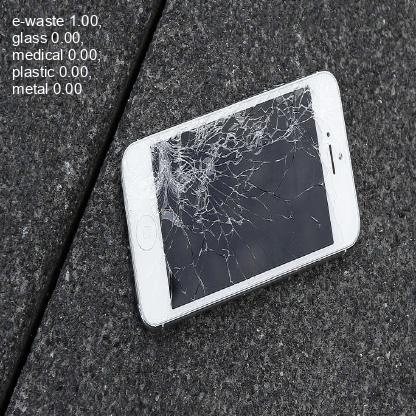



/content/runs/classify/predict8/e-waste 1518.jpg


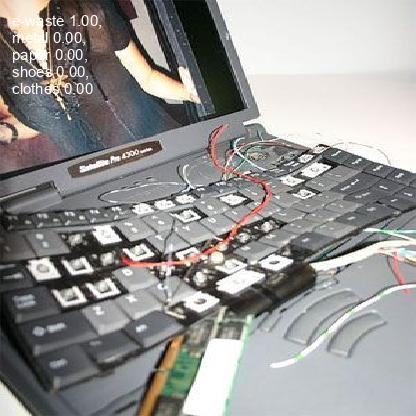



/content/runs/classify/predict8/e-waste 499.jpg


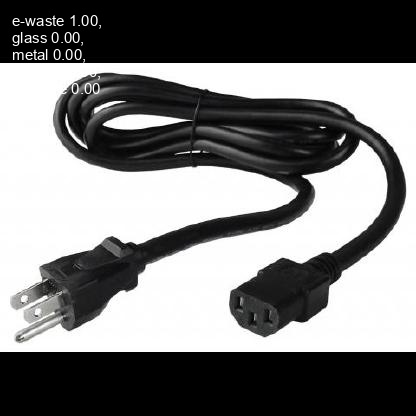



/content/runs/classify/predict8/e-waste 2174.jpg


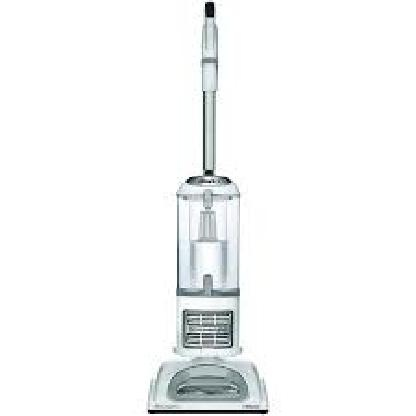



/content/runs/classify/predict8/e-waste 1793.jpg


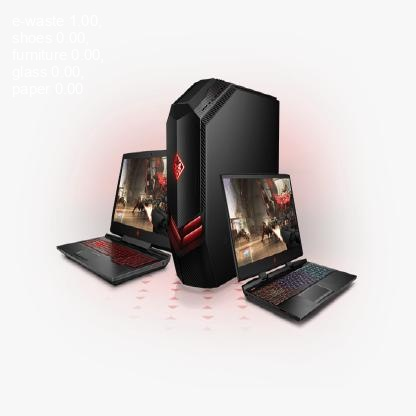



/content/runs/classify/predict8/e-waste 2505.jpg


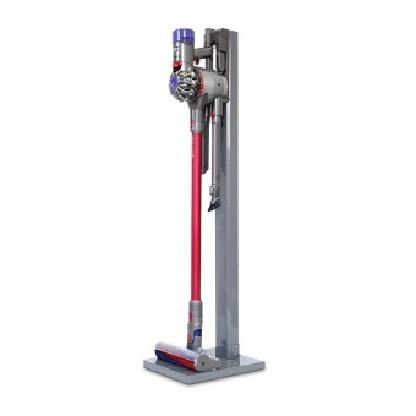

In [ ]:
for image_path in glob.glob(f'{HOME}/runs/classify/predict8/*.jpg')[:10]:
  print(image_path)
  display(Image(filename=image_path, height = 416))
  print('\n')

In [ ]:
!yolo task=classify mode=predict model={HOME}/drive/MyDrive/Data298AandB/data/train_val_test/runs/classify/train/weights/last.pt conf=0.25 source='{HOME}/drive/MyDrive/Data298AandB/data/train_val_test/test/cardboard'

Ultralytics YOLOv8.0.208 🚀 Python-3.10.12 torch-2.1.0+cu118 CUDA:0 (Tesla V100-SXM2-16GB, 16151MiB)
YOLOv8s-cls summary (fused): 73 layers, 5089291 parameters, 0 gradients, 12.5 GFLOPs

image 1/170 /content/drive/MyDrive/Data298AandB/data/train_val_test/test/cardboard/cardboard 101.jpg: 416x416 cardboard 1.00, medical 0.00, metal 0.00, e-waste 0.00, furniture 0.00, 3.4ms
image 2/170 /content/drive/MyDrive/Data298AandB/data/train_val_test/test/cardboard/cardboard 1010.jpg: 416x416 cardboard 1.00, glass 0.00, metal 0.00, plastic 0.00, clothes 0.00, 3.9ms
image 3/170 /content/drive/MyDrive/Data298AandB/data/train_val_test/test/cardboard/cardboard 102.jpg: 416x416 cardboard 1.00, e-waste 0.00, paper 0.00, furniture 0.00, plastic 0.00, 3.8ms
image 4/170 /content/drive/MyDrive/Data298AandB/data/train_val_test/test/cardboard/cardboard 1028.jpg: 416x416 cardboard 0.99, metal 0.01, paper 0.00, furniture 0.00, glass 0.00, 3.4ms
image 5/170 /content/drive/MyDrive/Data298AandB/data/train_val_test/

/content/runs/classify/predict9/cardboard 1626.jpg


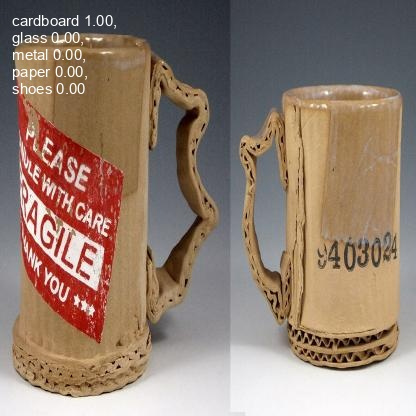



/content/runs/classify/predict9/cardboard 96.jpg


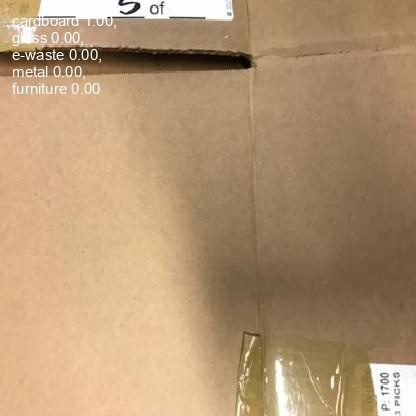



/content/runs/classify/predict9/cardboard 1090.jpg


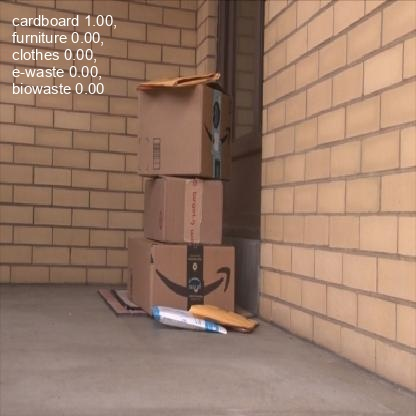



/content/runs/classify/predict9/cardboard 2366.jpg


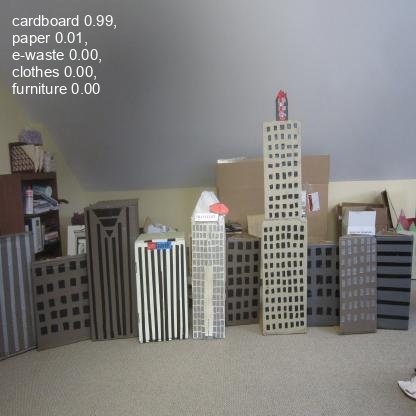



/content/runs/classify/predict9/cardboard 2217.jpg


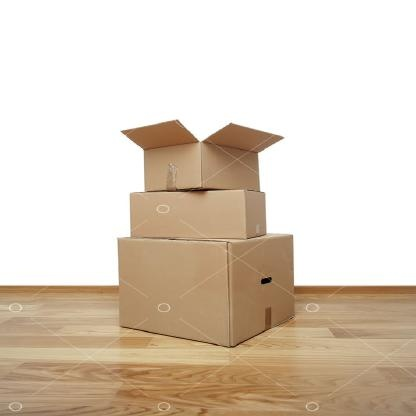



/content/runs/classify/predict9/cardboard 1998.jpg


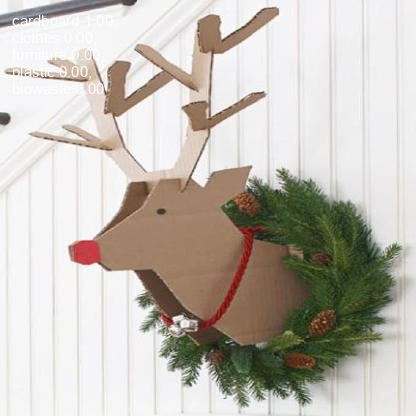



/content/runs/classify/predict9/cardboard 1507.jpg


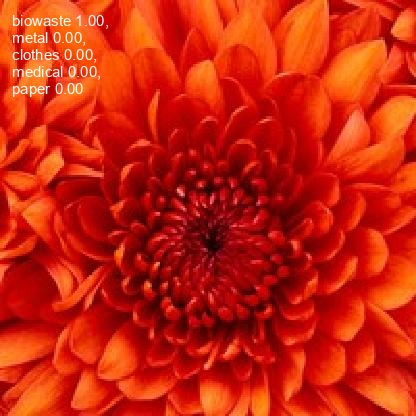



/content/runs/classify/predict9/cardboard 1057.jpg


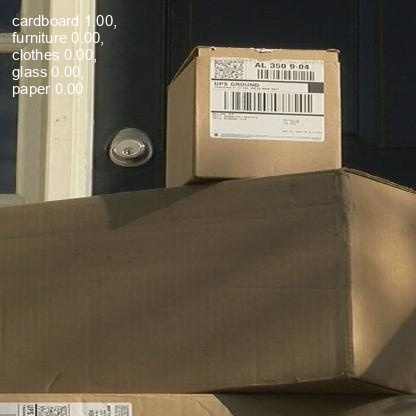



/content/runs/classify/predict9/cardboard 640.jpg


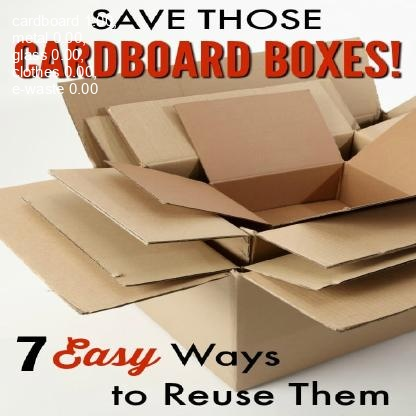



/content/runs/classify/predict9/cardboard 181.jpg


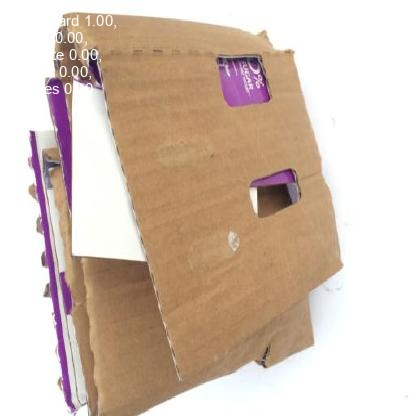

In [ ]:
for image_path in glob.glob(f'{HOME}/runs/classify/predict9/*.jpg')[:10]:
  print(image_path)
  display(Image(filename=image_path, height = 416))
  print('\n')

In [ ]:
!yolo task=classify mode=predict model={HOME}/drive/MyDrive/Data298AandB/data/train_val_test/runs/classify/train/weights/last.pt conf=0.25 source='{HOME}/drive/MyDrive/Data298AandB/data/train_val_test/test/paper'

Ultralytics YOLOv8.0.208 🚀 Python-3.10.12 torch-2.1.0+cu118 CUDA:0 (Tesla V100-SXM2-16GB, 16151MiB)
YOLOv8s-cls summary (fused): 73 layers, 5089291 parameters, 0 gradients, 12.5 GFLOPs

image 1/197 /content/drive/MyDrive/Data298AandB/data/train_val_test/test/paper/paper 1010.jpg: 416x416 paper 1.00, biowaste 0.00, cardboard 0.00, glass 0.00, metal 0.00, 3.5ms
image 2/197 /content/drive/MyDrive/Data298AandB/data/train_val_test/test/paper/paper 1011.jpg: 416x416 paper 1.00, biowaste 0.00, cardboard 0.00, glass 0.00, metal 0.00, 3.5ms
image 3/197 /content/drive/MyDrive/Data298AandB/data/train_val_test/test/paper/paper 1013.jpg: 416x416 glass 0.49, e-waste 0.38, paper 0.12, metal 0.01, shoes 0.00, 3.3ms
image 4/197 /content/drive/MyDrive/Data298AandB/data/train_val_test/test/paper/paper 1019.jpg: 416x416 paper 1.00, biowaste 0.00, metal 0.00, plastic 0.00, cardboard 0.00, 3.1ms
image 5/197 /content/drive/MyDrive/Data298AandB/data/train_val_test/test/paper/paper 1026.jpg: 416x416 paper 0.82

/content/runs/classify/predict10/paper 1328.jpg


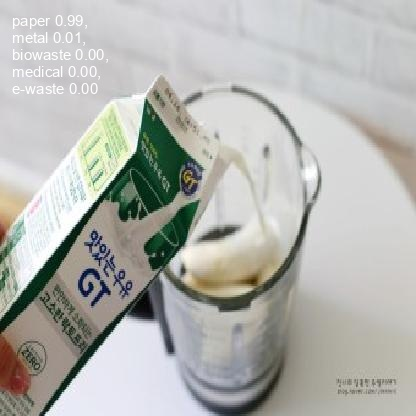



/content/runs/classify/predict10/paper 1334.jpg


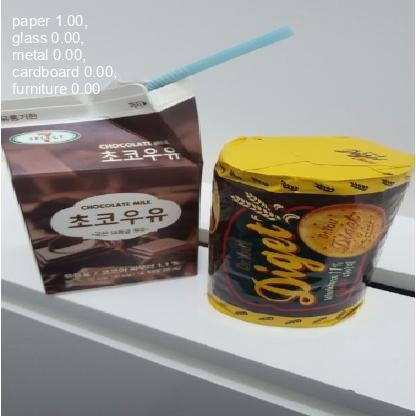



/content/runs/classify/predict10/paper 2286.jpg


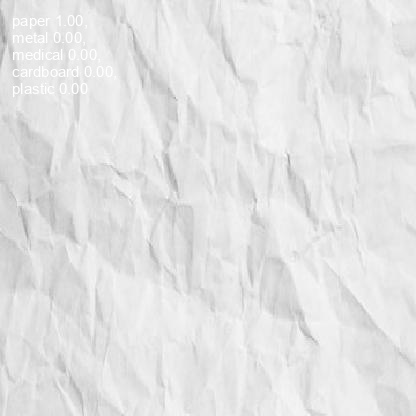



/content/runs/classify/predict10/paper 2118.jpg


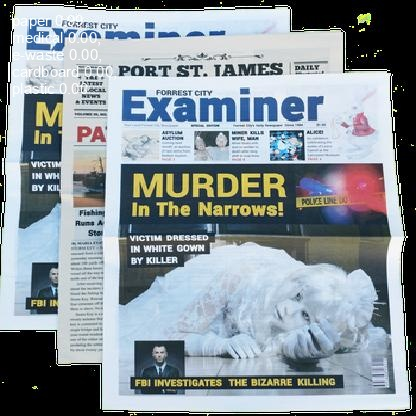



/content/runs/classify/predict10/paper 2584.jpg


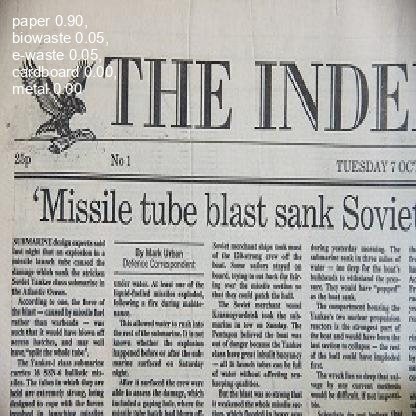



/content/runs/classify/predict10/paper 896.jpg


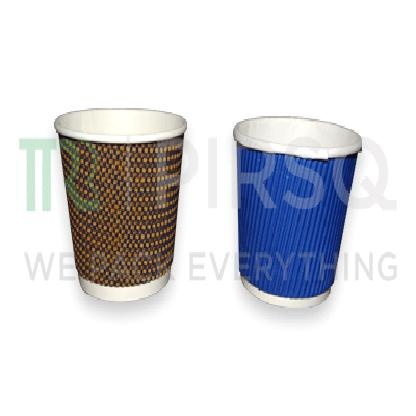



/content/runs/classify/predict10/paper 1228.jpg


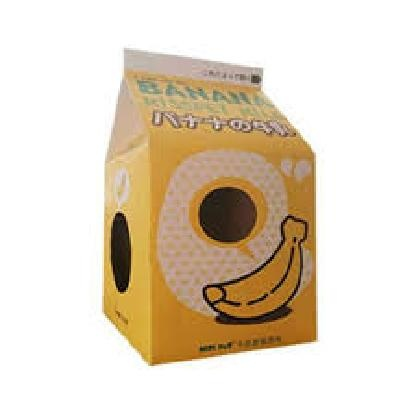



/content/runs/classify/predict10/paper 2173.jpg


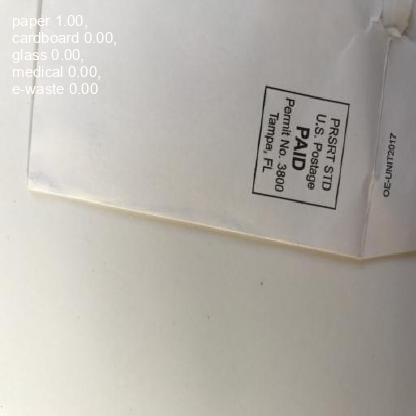



/content/runs/classify/predict10/paper 2490.jpg


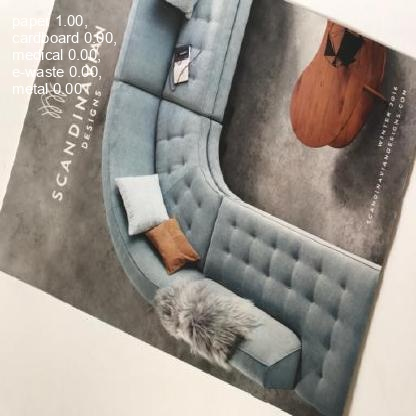



/content/runs/classify/predict10/paper 1833.jpg


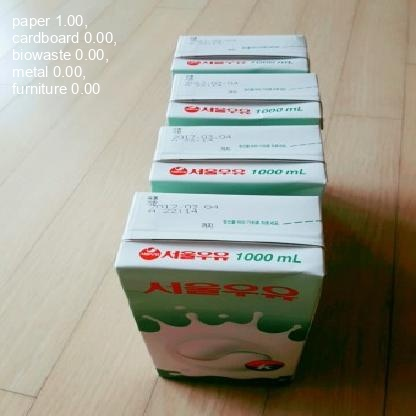

In [ ]:
for image_path in glob.glob(f'{HOME}/runs/classify/predict10/*.jpg')[:10]:
  print(image_path)
  display(Image(filename=image_path, height = 416))
  print('\n')

In [ ]:
!yolo task=classify mode=predict model={HOME}/drive/MyDrive/Data298AandB/data/train_val_test/runs/classify/train/weights/last.pt conf=0.25 source='{HOME}/drive/MyDrive/Data298AandB/data/train_val_test/test/metal'

Ultralytics YOLOv8.0.208 🚀 Python-3.10.12 torch-2.1.0+cu118 CUDA:0 (Tesla V100-SXM2-16GB, 16151MiB)
YOLOv8s-cls summary (fused): 73 layers, 5089291 parameters, 0 gradients, 12.5 GFLOPs

image 1/192 /content/drive/MyDrive/Data298AandB/data/train_val_test/test/metal/metal 1003.jpg: 416x416 metal 1.00, e-waste 0.00, paper 0.00, plastic 0.00, furniture 0.00, 3.2ms
image 2/192 /content/drive/MyDrive/Data298AandB/data/train_val_test/test/metal/metal 1014.jpg: 416x416 metal 0.85, medical 0.10, e-waste 0.02, glass 0.01, paper 0.01, 6.5ms
image 3/192 /content/drive/MyDrive/Data298AandB/data/train_val_test/test/metal/metal 1029.jpg: 416x416 e-waste 0.54, cardboard 0.22, metal 0.20, paper 0.03, glass 0.00, 3.4ms
image 4/192 /content/drive/MyDrive/Data298AandB/data/train_val_test/test/metal/metal 1037.jpg: 416x416 metal 1.00, shoes 0.00, glass 0.00, biowaste 0.00, cardboard 0.00, 3.3ms
image 5/192 /content/drive/MyDrive/Data298AandB/data/train_val_test/test/metal/metal 1045.jpg: 416x416 metal 1.00

/content/runs/classify/predict11/metal 290.jpg


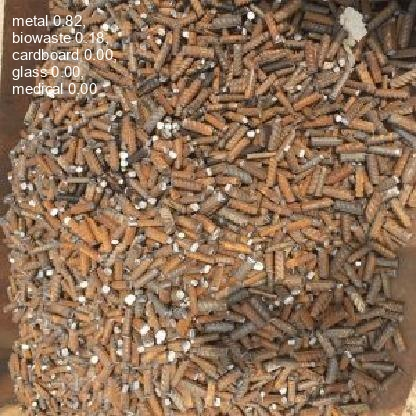



/content/runs/classify/predict11/metal 459.jpg


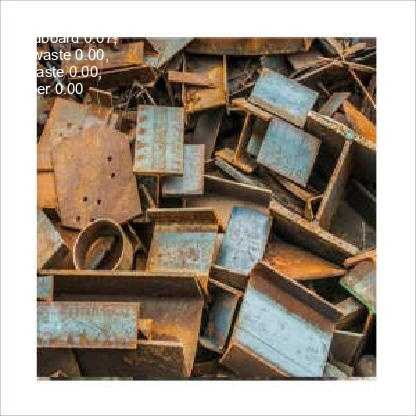



/content/runs/classify/predict11/metal 1199.jpg


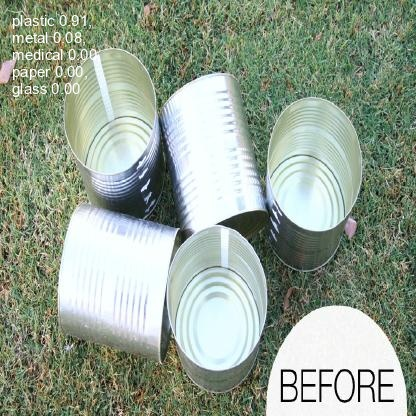



/content/runs/classify/predict11/metal 537.jpg


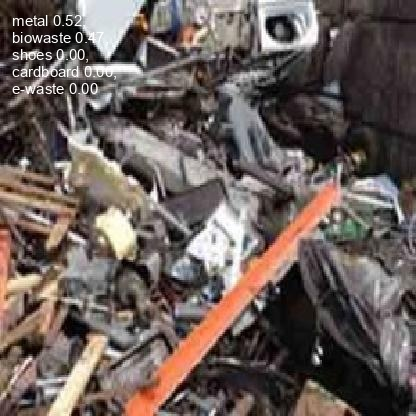



/content/runs/classify/predict11/metal 1140.jpg


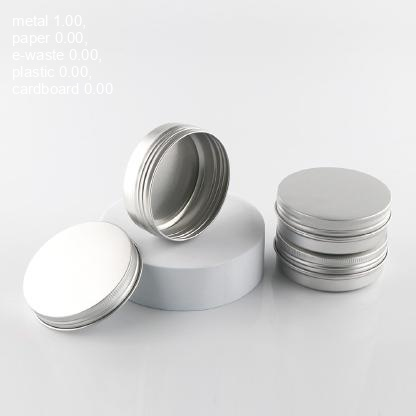



/content/runs/classify/predict11/metal 1846.jpg


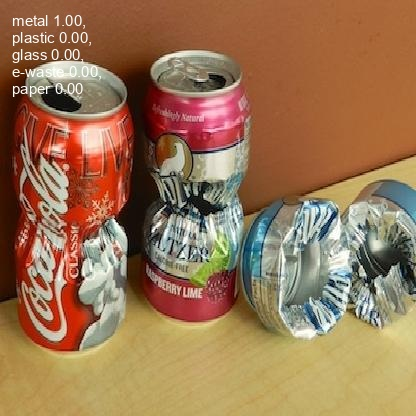



/content/runs/classify/predict11/metal 2341.jpg


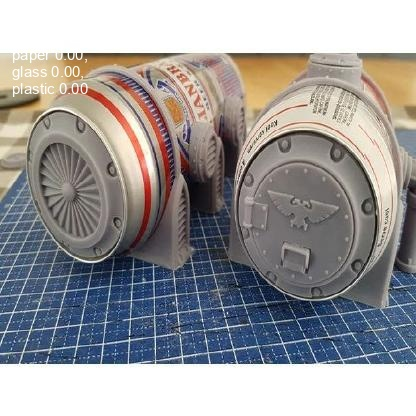



/content/runs/classify/predict11/metal 1014.jpg


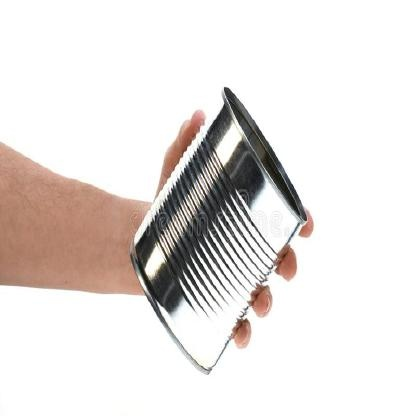



/content/runs/classify/predict11/metal 2234.jpg


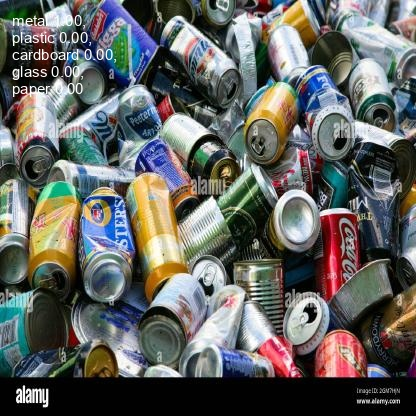



/content/runs/classify/predict11/metal 2051.jpg


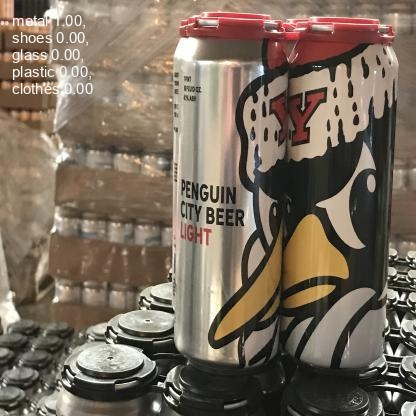

In [ ]:
for image_path in glob.glob(f'{HOME}/runs/classify/predict11/*.jpg')[:10]:
  print(image_path)
  display(Image(filename=image_path, height = 416))
  print('\n')